# Initializations
Before running first cell, make sure a nameserver is running on the network, the Qick board is connected to it, and the ip address listed below matches that of the nameserver. 

You just need to run the first cell, then should be able to run any other cell in whatever order. 

In [1]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from qick import QickConfig
from exp_handling.instrumentmanager import InstrumentManager
import experiments as meas
import config
from calib import qubit_tuning, tuneup
import handy
# import importlib 
# importlib.reload(meas)

%load_ext autoreload
%autoreload 2

# Configuration
ip = '192.168.137.1'
expt_path = 'C:\\_Data\\LLotsa\\Tuning_2025_01_11\\'
cfg_file = 'llotsa05.yml'
max_t1 = 75

# Set seaborn color palette
colors = ["#0869c8", "#b51d14", '#ddb310', '#658b38', '#7e1e9c', '#75bbfd', '#cacaca']
sns.set_palette(sns.color_palette(colors))

# Figure parameters
plt.rcParams['figure.figsize'] = [8, 4]
plt.rcParams.update({'font.size': 13})

print('Data will be stored in', expt_path)

# Results config file
cfg_path = os.path.join(os.getcwd(), 'configs', cfg_file)
auto_cfg = config.load(cfg_path)

# Connect to instruments
im = InstrumentManager(ns_address=ip)
print(im)
soc = QickConfig(im[auto_cfg['aliases']['soc']].get_cfg())
print(soc)

num_qubits = len(auto_cfg.device.qubit.f_ge)
cfg_dict = {'soc': soc, 'expt_path': expt_path, 'cfg_file': cfg_path, 'im': im}


imported experiments.single_qubit.active_reset
imported experiments.single_qubit.inactive
imported experiments.single_qubit.pulse_probe_spectroscopy
imported experiments.single_qubit.rabi
imported experiments.single_qubit.resonator_spectroscopy
imported experiments.single_qubit.single_shot
imported experiments.single_qubit.t1
imported experiments.single_qubit.t1_cont
imported experiments.single_qubit.t1_stark
imported experiments.single_qubit.t2_echo
imported experiments.single_qubit.t2_ramsey
imported experiments.single_qubit.t2_ramsey_stark
imported experiments.single_qubit.tof_calibration
imported experiments.two_qubit.rabi_2q
imported experiments.two_qubit.t1_2q
imported experiments.two_qubit.t1_2q_cont
imported experiments.two_qubit.t1_2q_conttest
Data will be stored in C:\_Data\LLotsa\Tuning_2025_01_11\
{'Pyro.NameServer': <Pyro4.core.Proxy at 0x20a94b78220; not connected; for PYRO:Pyro.NameServer@192.168.137.1:9090>, 'Qick233': <Pyro4.core.Proxy at 0x20a94b783a0; not connected; 

## Set up new config or data folder

After running, move expt_path and cfg_file to the first cell. 

In [2]:
new_config = False
new_folder = False

if new_config or new_folder:
    expt_path = 'C:\\_Data\\LLotsa\\Tuning_2024_12_20_tprocv2\\'
    if new_config:
        cfg_file='llotsa05.yml'
        config.init_config( os.getcwd() + '\\configs\\' + cfg_file, 20, type='full', aliases='Qick233', t1=30)

    os.mkdir(expt_path)
    os.mkdir(expt_path + 'images')
    os.mkdir(expt_path + 'images\\summary')

## Signalcore init

In [3]:
sc1 = im['SC1']
sc2 = im['SC2']

sc1.open_device()
sc2.open_device()

def set_frequency(sc, freq):
    sc.set_standby(enable = True)
    sc1.set_frequency(freq*1e6)
    sc2.set_standby(enable = False)
    time.sleep(5)

def set_power(sc, power):
    sc.set_standby(enable = True)

    sc.set_power(power)
    sc.set_standby(enable = False)

    time.sleep(5)

KeyError: 'SC1'

In [ ]:
sc1.set_power(13)
sc2.set_power(13)

In [ ]:
sc1
sc1.close_device()

## Check QICK mirror frequencies

In [3]:
import qick_check

qick_check.check_freqs(3, cfg_dict['cfg_file'])

We mirror around 4792.32
Possible frequencies are 5054.5825 and 4530.057499999999
Possible ef frequencies are 4865.8348 and 4718.8052
Anharmonicity is 188.7477000000008. With alt_ef it is 335.77730000000065
Both ef frequencies are less than chosen freq and greater than alt freq, so freq is correct choice


Note: make sure you set your ADC/DAC channels correctly. This code does not automatically fill in the ADC/DAC into your configuration file, so you should check yourself to make sure these values are correct. 

# Time of Flight (TOF)

TOF measures the time it takes for the signal to run through the wires. It will give us the time in clock ticks that we should wait to make a measurements 

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00041.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00041.h5


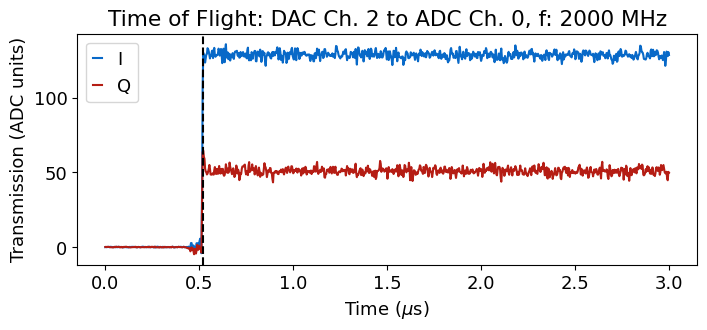

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00042.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00042.h5


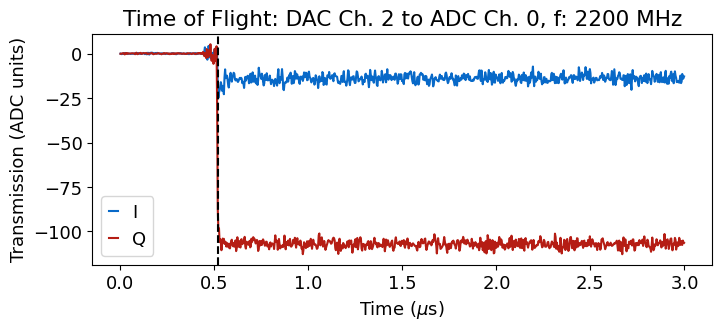

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00043.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00043.h5


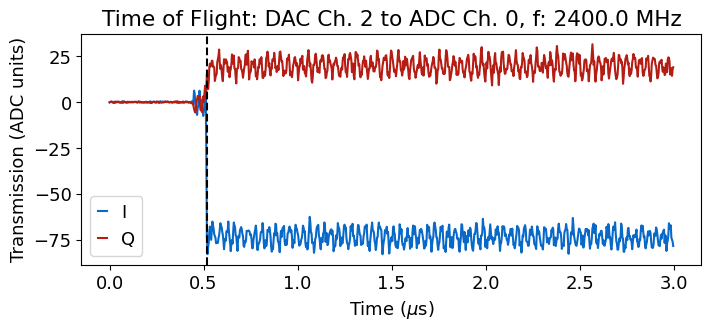

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00044.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00044.h5


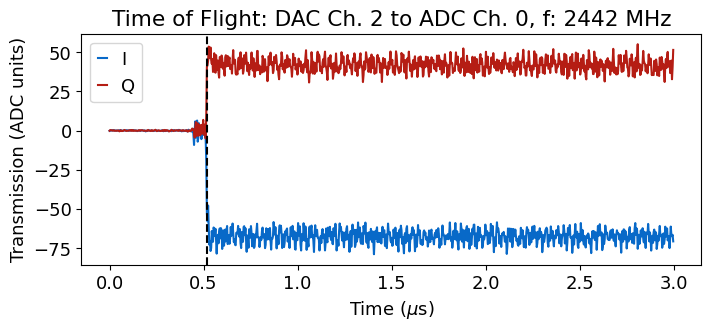

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00045.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00045.h5


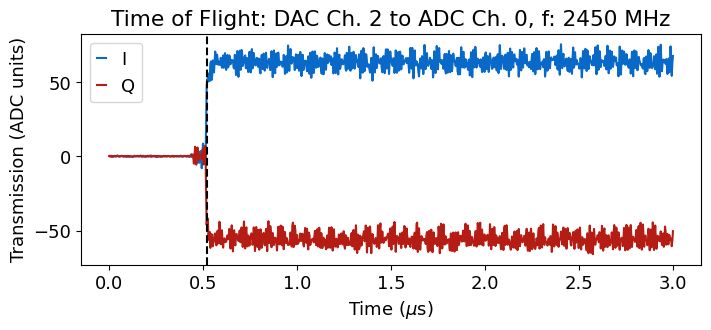

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00046.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00046.h5


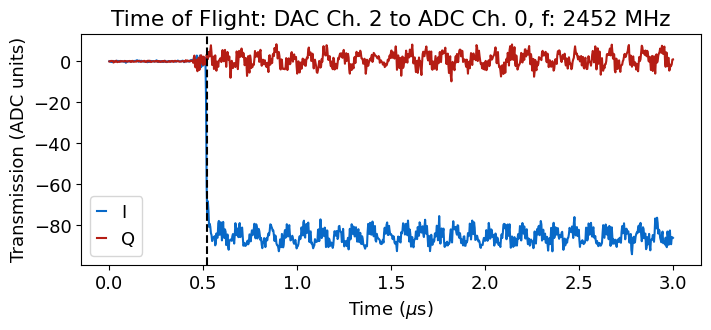

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00047.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00047.h5


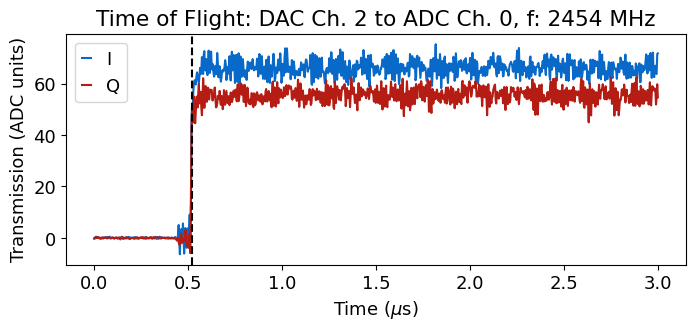

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00048.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00048.h5


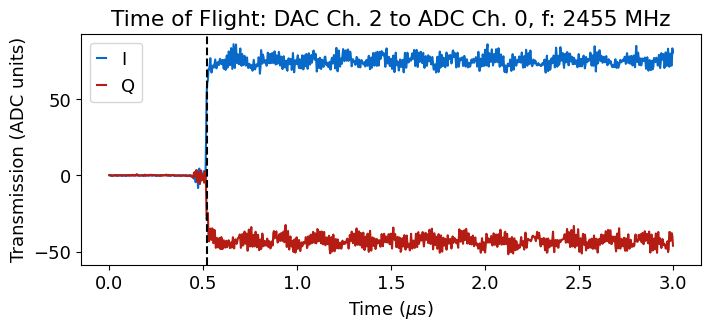

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00049.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00049.h5


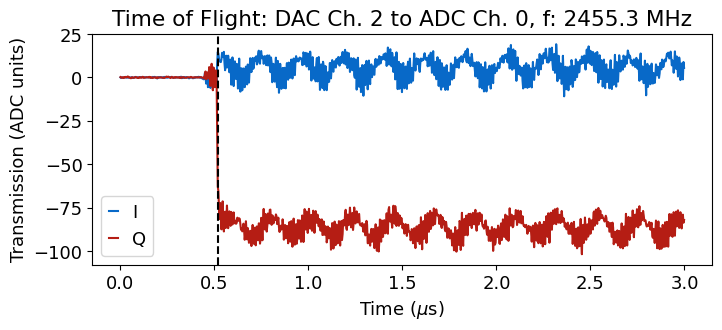

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00050.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00050.h5


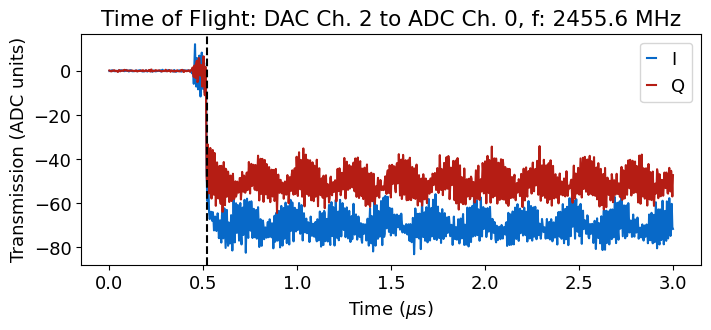

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00051.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00051.h5


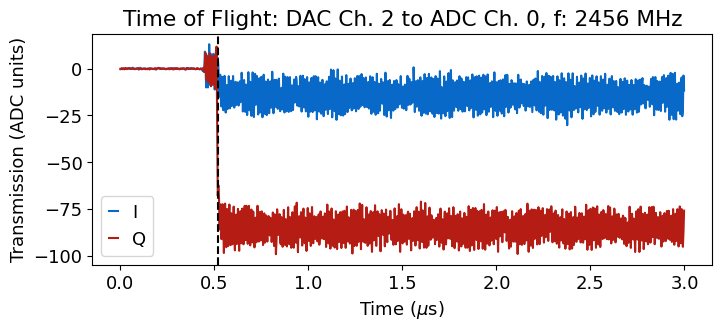

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00052.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00052.h5


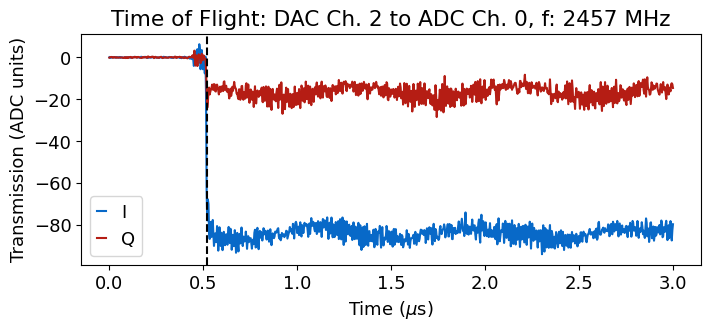

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00053.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00053.h5


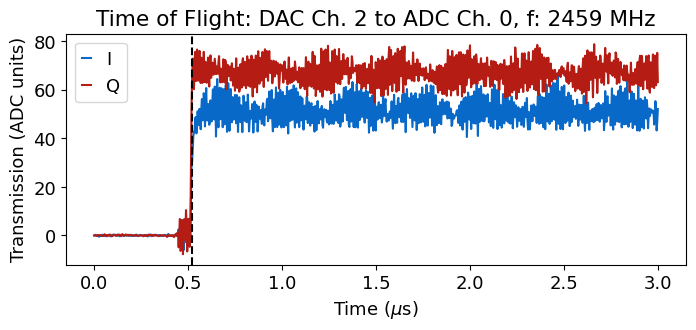

  0%|          | 0/1000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00054.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\adc_trig_offset_calibration_qubit10_00054.h5


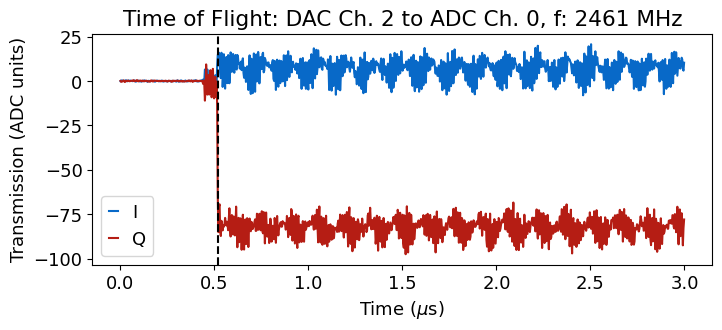

In [10]:
qubit_list = np.arange(3)
qubit_list = [10]
f = [2450,24]
#f = [2800,2900,3000,3100]
#f= [1900,2200]
f = [2000,2200,2400.0, 2442, 2450, 2452, 2454, 2455, 2455.3, 2455.6, 2456, 2457, 2459, 2461]
for fi in f: 
        for qi in qubit_list:        
                tof=meas.ToFCalibrationExperiment(cfg_dict=cfg_dict, qi=qi,params={'frequency':fi})
# use this to set trig_offset in config file

# Resonator Spectroscopy 

Run resonator spectroscopy for all resonators by choosing a large frequency scan to look over. The scan will then find the different resonators and fill in the config file with their respective frequencies. In the autocalibration, there will be a finer sweep of each resonator to more accurately find its frequency. The frequencies are saved in <code>auto_cfg.device.readout.frequency</code>

## Coarse 

This will perform peak finding

  0%|          | 0/2000000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_coarsecoarse_qubit0_00018.h5
Number of peaks: 0


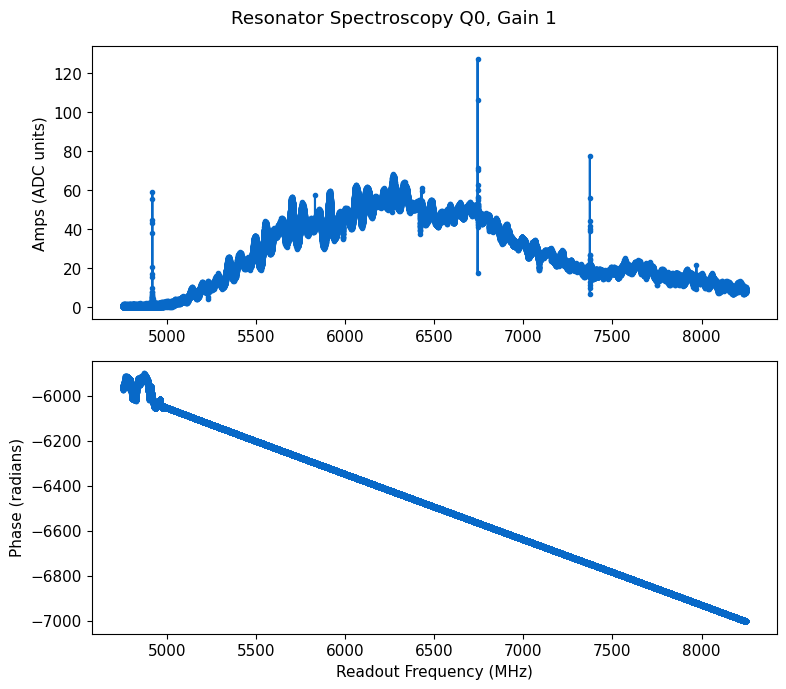

In [334]:
#rspec = cfg.make_rspec_coarse(soc, expt_path, cfg_path, i, im=im, start=6000, span=800, reps=2000, npts=5000)
qi=0
rspecc = meas.ResSpec(cfg_dict, qi=qi, style='coarse', params={'start':150, 'span':3500, 'soft_avgs':1, 'reps':20, 'gain':1, 'expts':100000})
res_values = rspecc.data['coarse_peaks']

Change prom (prominence value) to adjust how to find the peaks

In [ ]:
rspecc.analyze(peaks=True, debug=True, fit=False, prom=0.05)
rspecc.display(peaks=True, fit=False)
res_values = rspecc.data['coarse_peaks']

Can delete values from res_values if they don't seem to be real res_values. 

In [23]:
res_values = np.delete(res_values,1)

## Fine

  0%|          | 0/27000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_fine_qubit0_00082.h5


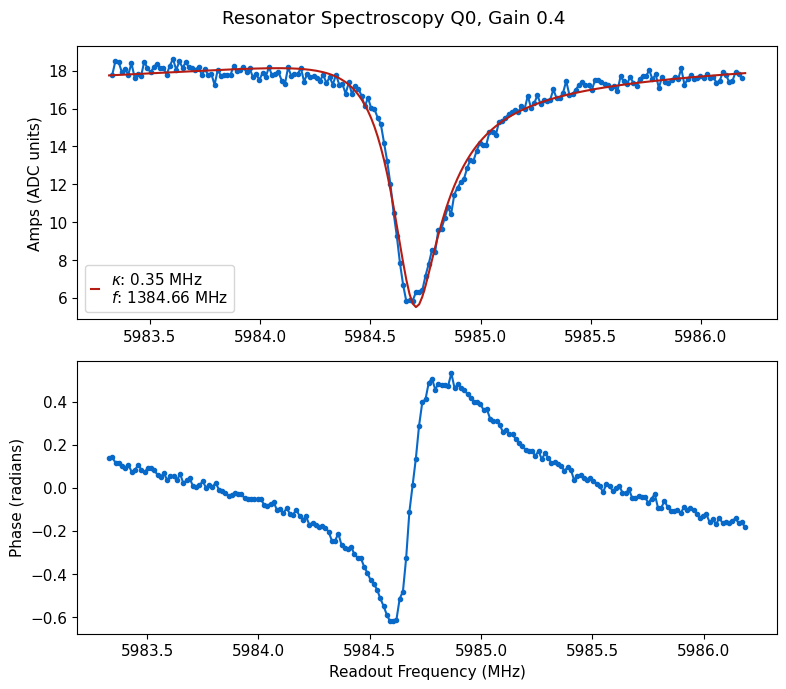

*Set cfg readout 0 frequency to 1384.6635 from 1384.7585*
*Set cfg readout 0 qi to 6.0375 from 6.6718*
*Set cfg readout 0 qe to 2.3416 from 2.2057*
*Set cfg readout 0 kappa to 0.3547 from 0.361*


In [335]:
# Just run one  
update=True

# qubit_list = np.arange(0,10)
qubit_list=[0]
for qi in qubit_list:    
    #rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':5, 'center':res_values[qi], 'gain':0.25}) # Use this to sweep through the res_values list
    rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':'kappa'})
    #rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':5, 'gain':0.9})
    if rspec.status and update:
        auto_cfg = config.update_readout(cfg_path, 'frequency', float(rspec.data['freq_min']), qi)
        auto_cfg = config.update_readout(cfg_path, 'qi', float(rspec.data['fit'][1]), qi)
        auto_cfg = config.update_readout(cfg_path, 'qe', float(rspec.data['fit'][2]), qi)
        auto_cfg = config.update_readout(cfg_path, 'kappa', float(rspec.data['kappa']), qi)

In [ ]:
config.update_lo(cfg_path, 'gain', 0.18, qi);

## Resonator Power Spectroscopy 

Find a good value for gain to park your readout at until you run readout optimization. From the 2D sweep that is produced, choose a value for gain that is right before the resonator 'breaks' (goes from e -> f). Want to choose a high value for gain because we want to be in the shot noise limited regime which increases our signal:noise ratio. The gain value should be saved in <code>auto_cfg.device.readout.gain</code>

[0, 0, 0, 1, 1, 1, 2, 3, 4, 6, 8, 12, 17, 24, 34, 48, 69, 99, 142, 203]


  0%|          | 0/20 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_power_sweep_qubit0_00005.h5
High power peak [MHz]: 1384.7990411105122
Low power peak [MHz]: 1384.8022632653006
Lamb shift [MHz]: -0.003222154788318221


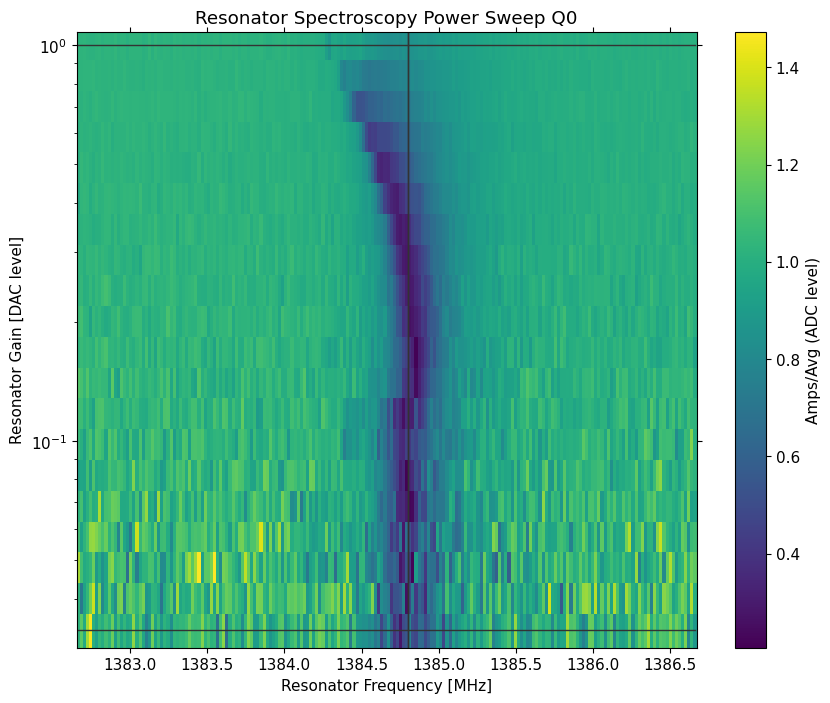

[0, 0, 1, 1, 1, 1, 2, 3, 4, 6, 9, 13, 18, 26, 37, 53, 76, 109, 156, 224]


  0%|          | 0/20 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_power_sweep_qubit10_00005.h5
High power peak [MHz]: 988.3722171068109
Low power peak [MHz]: 985.607873494401
Lamb shift [MHz]: 2.7643436124099026


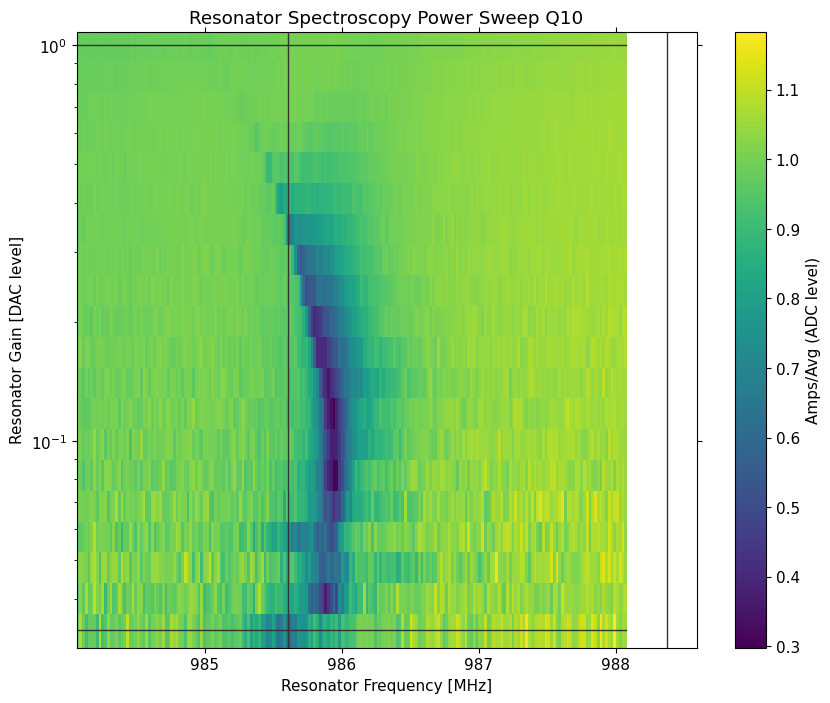

In [336]:
update=False
qubit_list = [0,10]
d=[]
#qubit_list=[7]
for qi in qubit_list:
    #rpowspec=meas.ResSpecPower(cfg_dict, qi=qi)
    rpowspec=meas.ResSpecPower(cfg_dict, qi=qi, params={'rng':30, 'span':4,"f_off":0})
    d.append(rpowspec)
    if update:
        auto_cfg = config.update_readout(cfg_path, 'lamb', float(rpowspec.data['lamb_shift']), qi)


In [ ]:
auto_cfg = config.load(cfg_path)
horz_line = auto_cfg.device.readout.gain
handy.plot_many(d, title='Resonator Power', save_path=cfg_dict['expt_path'], chan='amps', yax='log', norm=True, horz_line=horz_line)

### Save gain values 

In [ ]:
# assign the resonator gain to the results config file
gain_values = [0.1,0.01]
for i in range(num_qubits):
    auto_cfg = config.update_readout(cfg_file, 'gain', int(gain_values[i]), i)

### Check effect of changing LO power

In [ ]:
lo = [0.01,0.02,0.04, 0.08, 0.16, 0.3, 0.5]
d=[]
for l in lo:
    config.update_lo(cfg_path, 'gain', l, qi)
    qubit_list=[10]
    for qi in qubit_list:
        rpowspec=meas.ResSpecPower(cfg_dict, qi=qi, params={'rng':10})
        d.append(rpowspec)

fig, ax = plt.subplots(3,3, figsize=(10,10))
ax = ax.flatten()
fig.suptitle('Lamb Shift')
for i in range(len(d)):
    ax[i].pcolormesh(d[i].data['xpts'],d[i].data['ypts'],d[i].data['amps'])
    ax[i].set_title(f"LO gain {lo[i]}")
    fig.colorbar(ax[i].collections[0], ax=ax[i])
fig.tight_layout()


# Qubit Spectroscopy

Now that things seems to be working, can thinking about getting rid of sections for different scan widths/powers; unless it's nice to keep the old data displayed in multiple cells?

## Find qubits

2


  0%|          | 0/29800 [00:00<?, ?it/s]

R2:0.864	Fit par error:0.025	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy__medium_qubit10_00005.h5


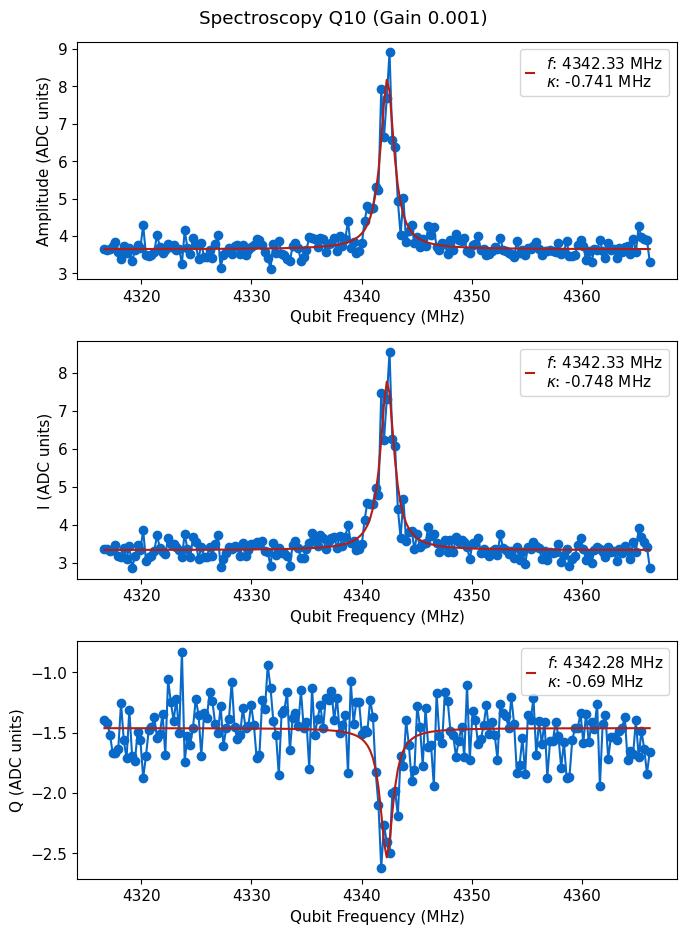

*Set cfg qubit 10 f_ge to 4342.3267 from 4341.4*
3


  0%|          | 0/29800 [00:00<?, ?it/s]

R2:0.788	Fit par error:0.064	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy__fine_qubit10_00026.h5


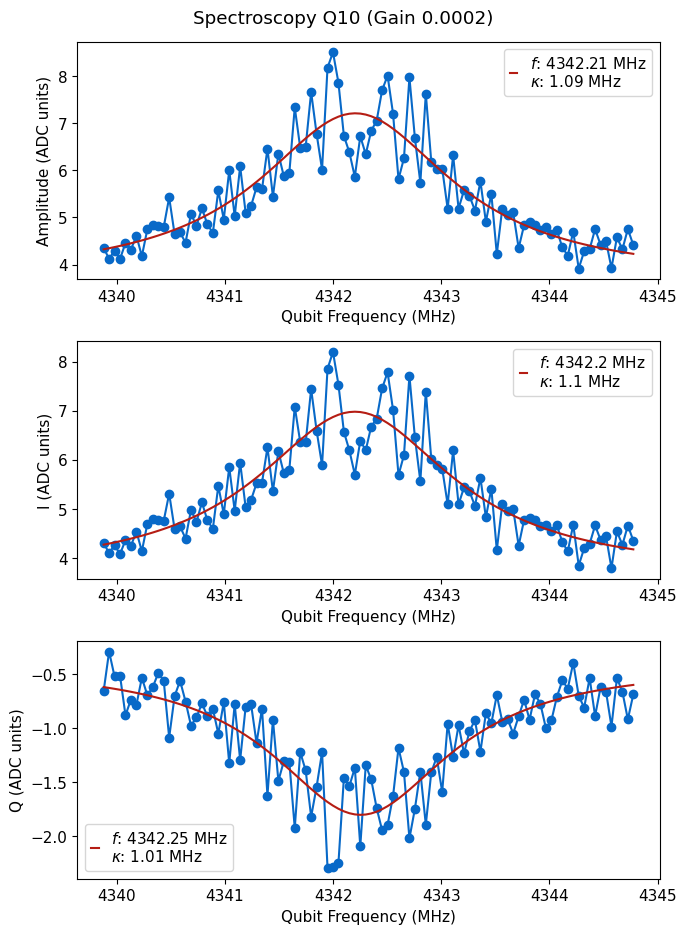

*Set cfg qubit 10 f_ge to 4342.2052 from 4342.3267*
Found qubit 10


In [214]:
qubit_list= [10]
#qubit_list = [11]
bad_qubits=[]
for qi in qubit_list:
    status, ntries = qubit_tuning.find_spec(qi, cfg_dict, start='medium')
    if not status:
        bad_qubits.append(qi)

### Updating frequencies (currently defunct, not using peak finding)

In [ ]:
# Here, choose which peak you want to save the value for, adjust index accordingly
auto_cfg = config.update_qubit(cfg_file, 'f_ef', float(qspec.data["coarse_peaks_x"][0]), i)
auto_cfg = config.update_qubit(cfg_file, 'f_ge', float(qspec.data["coarse_peaks_x"][1]), i)

## General search, specify width 

fine, medium, coarse, huge (will change scan width and power)

  0%|          | 0/27000 [00:00<?, ?it/s]

R2:0.850	Fit par error:0.036	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy__fine_qubit0_00027.h5


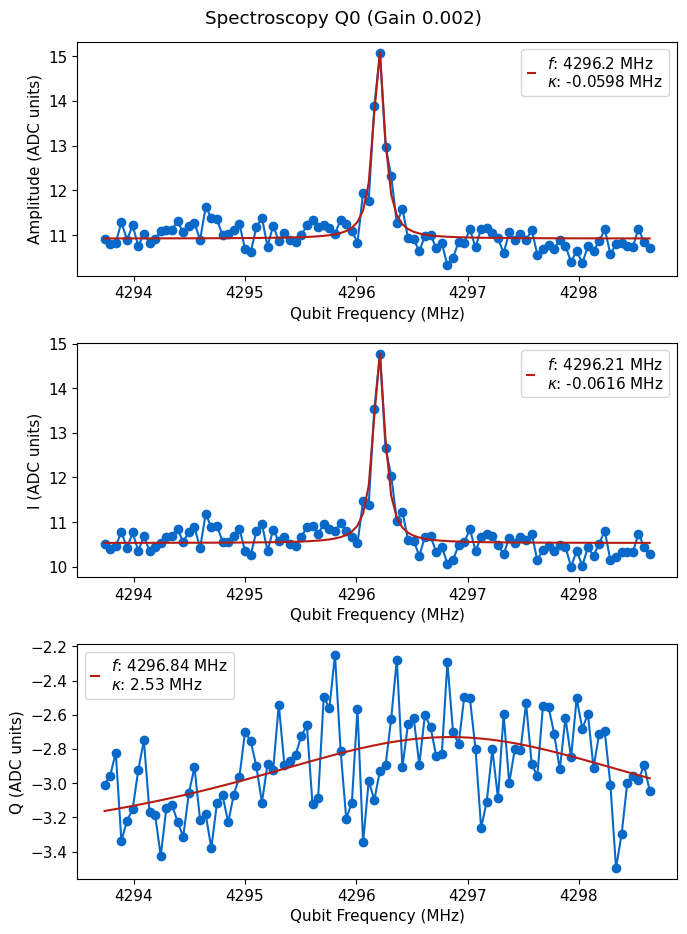

Bad qubit!


In [385]:
qubit_list = [0]
update=False
#qubit_list = np.arange(5)
for qi in qubit_list: 
    qspec=meas.QubitSpec(cfg_dict, qi=qi, style='fine')
    if update and qspec.status: 
        auto_cfg = config.update_qubit(cfg_path, 'f_ge', qspec.data["best_fit"][2], qi)
        auto_cfg = config.update_qubit(cfg_path, 'kappa',2*qspec.data["best_fit"][3], qi)
    else:
        print('Bad qubit!')


## Power sweep

### Wide scan looking for qubit

In [ ]:
qubit_list = np.arange(20)
#qubit_list=[0]
d = []
for qi in qubit_list:
    qi = meas.QubitSpecPower(cfg_dict, qi=qi, style='coarse', params={'max_gain':0.3})
    d.append(qi)
handy.plot_many(d, title='Qubit Power', save_path=cfg_dict['expt_path'], yax='log', chan='amps')

### Narrow scan

  0%|          | 0/10 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\finequbit_spectroscopy_power_qubit0_00000.h5


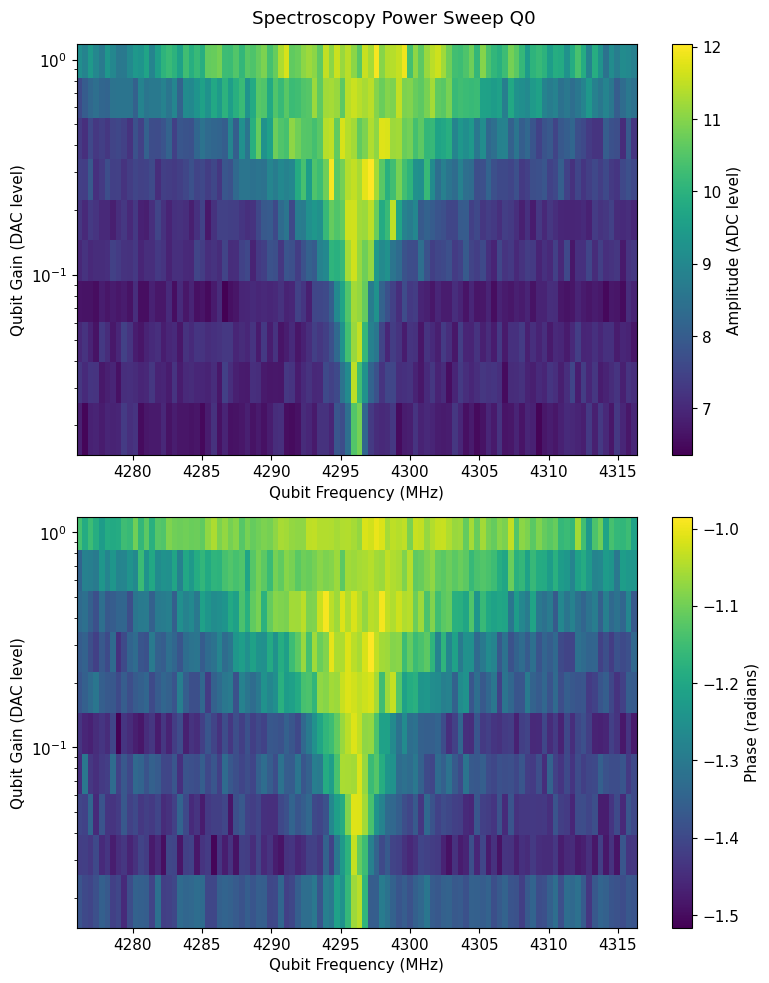

IndexError: list index out of range

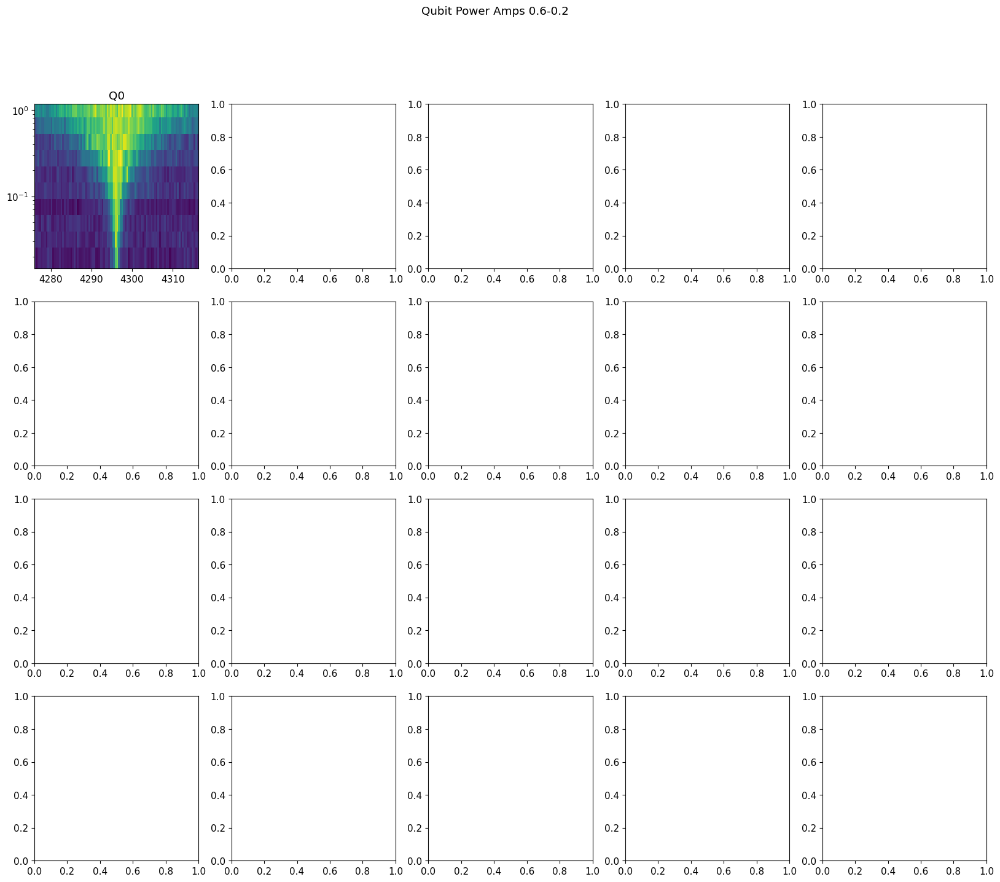

In [341]:
qq=[]
# qubit_list = np.arange(20)
qubit_list=[0]
for qi in qubit_list:
    qspec_pow = meas.QubitSpecPower(cfg_dict, qi=qi, style='fine', params={'length':'t1','max_gain':1})
    # expts_gain=13, rng=300, soft_avgs=2, len='t1', span=60)
    qq.append(qspec_pow)
#handy.plot_many(qq, title='Qubit Power Amps 0.6-0.2', save_path=cfg_dict['expt_path'], yax='log', chan='amps')
#handy.plot_many(qq, title='Qubit Power Phase 0.6-0.2', save_path=cfg_dict['expt_path'], yax='log', chan='phases')

In [424]:
auto_cfg = config.update_qubit(cfg_path, 'tuned_up',False, 1)

*Set cfg qubit 1 tuned_up to False from True*


# Coherent scans

## Fast Tuneup

  0%|          | 0/29800 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_fine_qubit10_00079.h5


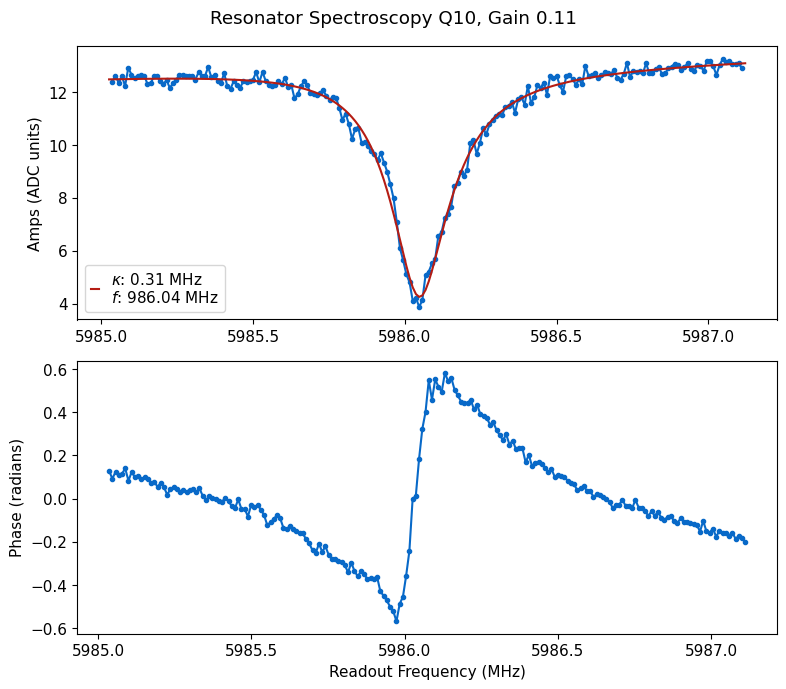

*Set cfg readout 10 frequency to 986.0407 from 986.075*
*Set cfg readout 10 qi to 5.931 from 8.84*
*Set cfg readout 10 qe to 2.8993 from 3.0748*
*Set cfg readout 10 kappa to 0.3074 from 0.2624*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00385.h5


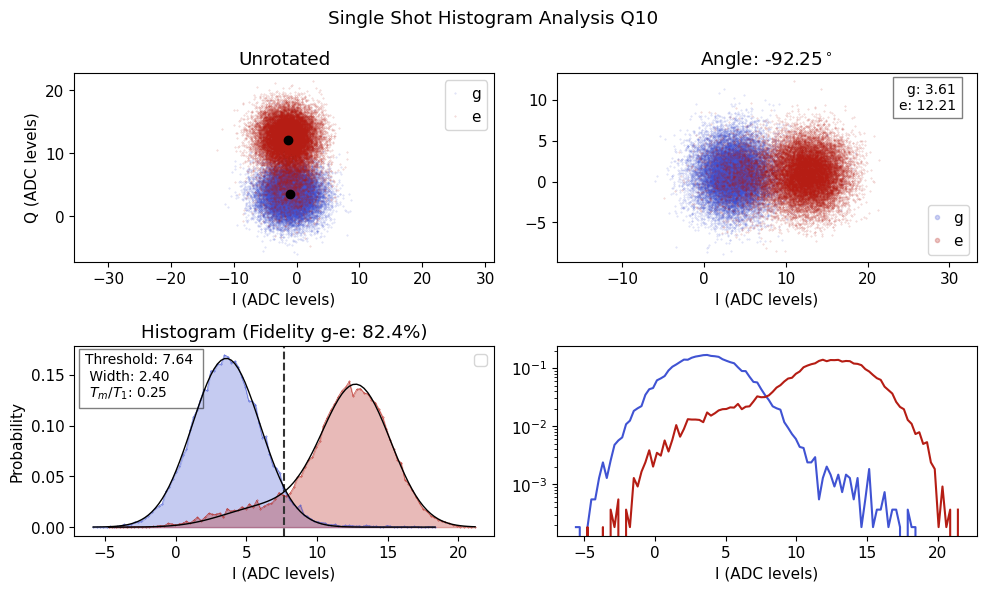

ge Fidelity (%): 82.420
Rotation angle (deg): -92.250
Threshold ge: 7.639
*Set cfg readout 10 phase to -92.25 from -51.1743*
*Set cfg readout 10 threshold to 7.6385 from 7.5215*
*Set cfg readout 10 fidelity to 0.8242 from 0.8133*
*Set cfg readout 10 sigma to 2.402 from 2.4241*
*Set cfg readout 10 tm to 0.2495 from 0.2477*
*Set cfg qubit 10 tuned_up to True from True*


  0%|          | 0/2 [00:00<?, ?it/s]

R2:0.956	Fit par error:0.025	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy__fine_qubit10_00027.h5


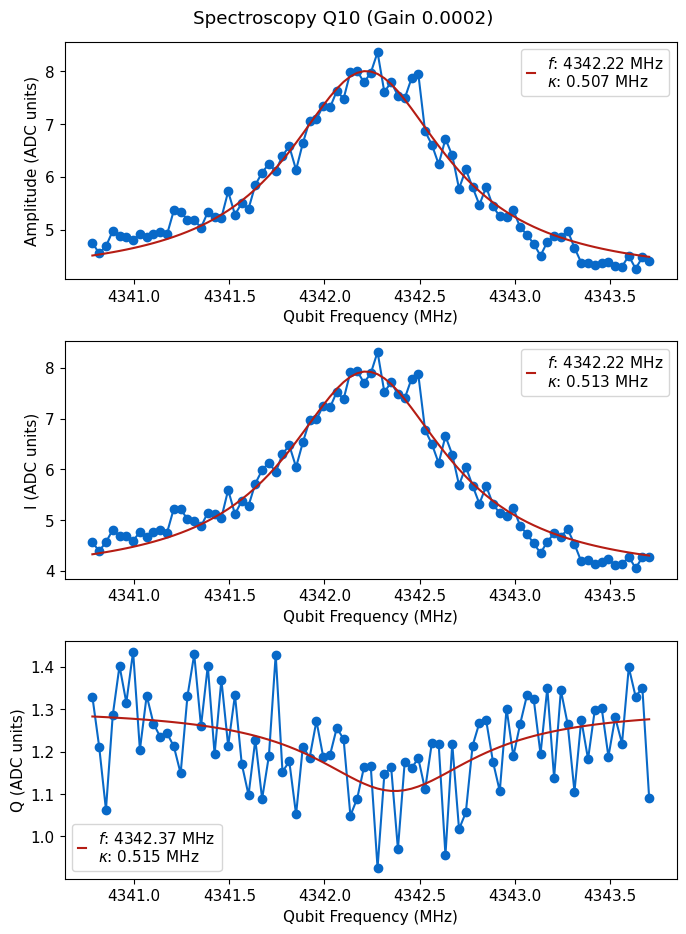

  0%|          | 0/8940 [00:00<?, ?it/s]

R2:0.983	Fit par error:0.016	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi__qubit10_00102.h5


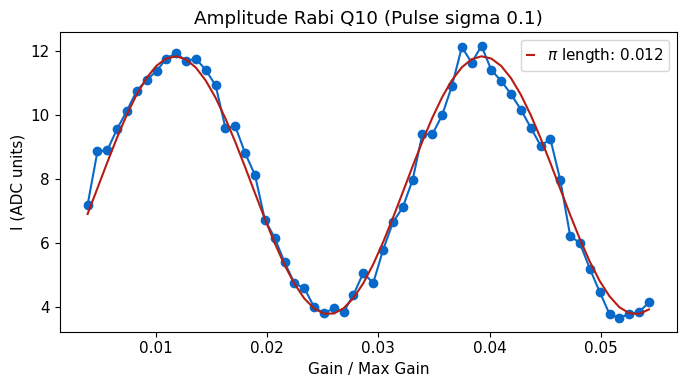

*Set cfg qubit 10 ('pulses', 'pi_ge', 'gain') to 0.0118 from 0.0114*
Try 0


  0%|          | 0/29800 [00:00<?, ?it/s]

R2:0.943	Fit par error:0.036	 Best fit:b'avgi'
Possible errors are -0.007 and 0.407 for Ramsey frequency 0.200 MHz
Saving C:\_Data\LLotsa\Tuning_2025_01_11\ramsey_qubit10_00182.h5


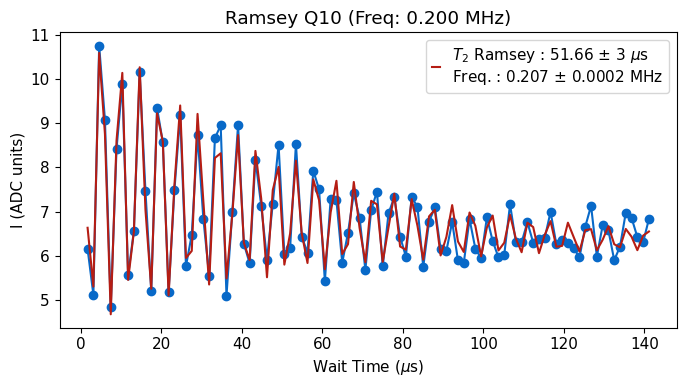

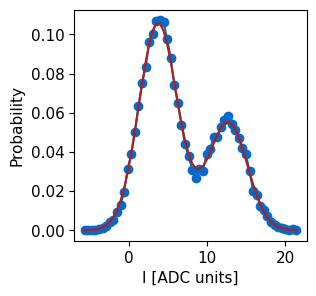

Scan successful. New f error is -0.007 MHz
*Set cfg qubit 10 f_ge to 4342.2371 from 4342.2437*
*Set cfg qubit 10 T2r to 51.6625 from 47.43*
Total Change in frequency: -0.007 MHz
[-0.006579718375798016]
Qubit 10 recentered from 4342.2437 to 4342.2371


  0%|          | 0/8940 [00:00<?, ?it/s]

R2:0.979	Fit par error:0.017	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi__qubit10_00103.h5


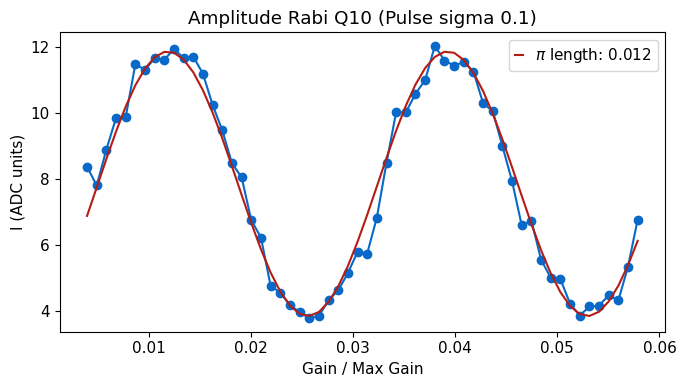

*Set cfg qubit 10 ('pulses', 'pi_ge', 'gain') to 0.0119 from 0.0118*


  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00386.h5


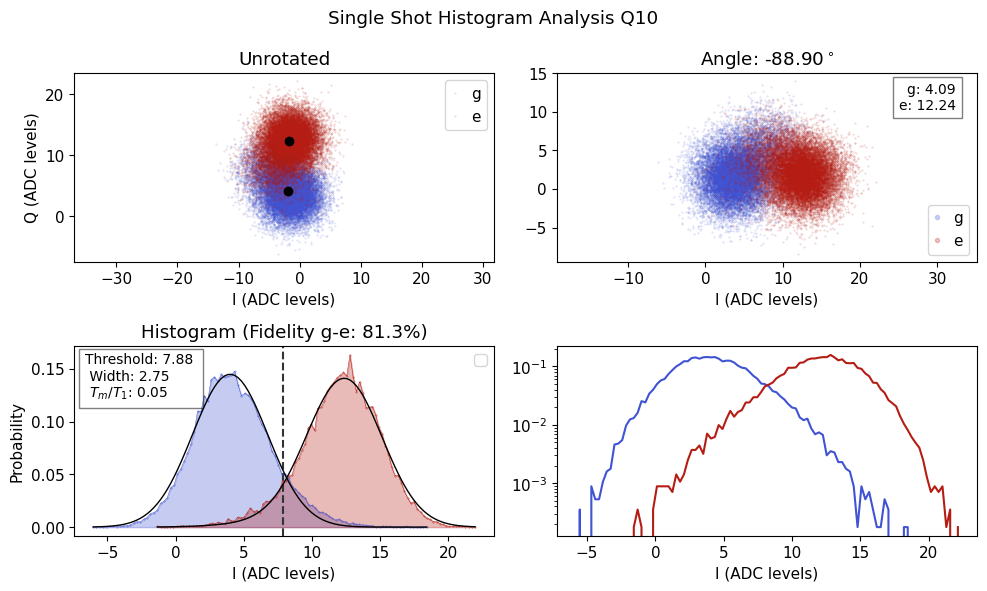

ge Fidelity (%): 81.270
Rotation angle (deg): -88.895
Threshold ge: 7.879
*Set cfg readout 10 phase to -88.895 from -92.25*
*Set cfg readout 10 threshold to 7.879 from 7.6385*
*Set cfg readout 10 fidelity to 0.8127 from 0.8242*
*Set cfg readout 10 sigma to 2.7537 from 2.402*
*Set cfg readout 10 tm to 0.0452 from 0.2495*
{}


  0%|          | 0/29800 [00:00<?, ?it/s]

R2:0.945	Fit par error:0.041	 Best fit:b'avgi'
Possible errors are 0.000 and 0.061 for Ramsey frequency 0.030 MHz
Saving C:\_Data\LLotsa\Tuning_2025_01_11\ramsey_qubit10_00183.h5


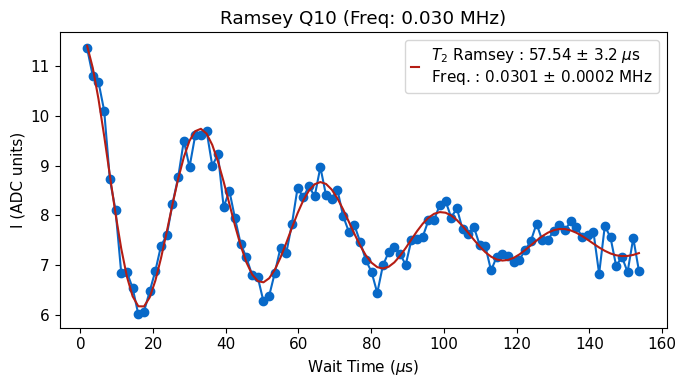

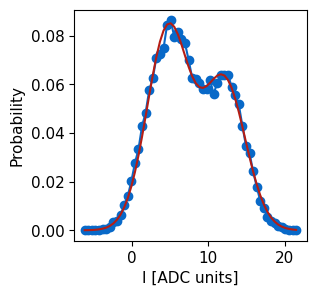

*Set cfg qubit 10 T2r to 57.54 from 51.6625*
{}


  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.978	Fit par error:0.040	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00121.h5


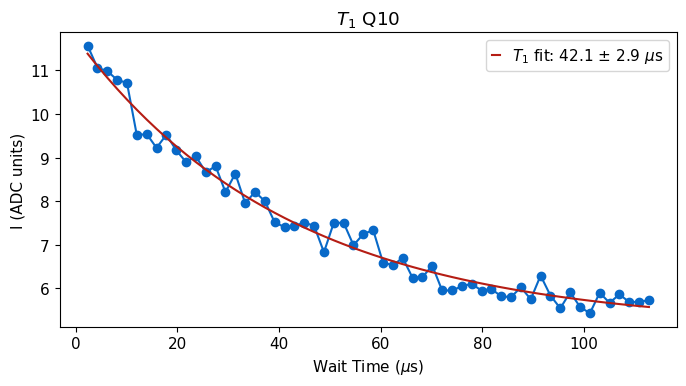

*Set cfg qubit 10 T1 to 42.14 from 30.92*


  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.987	Fit par error:0.023	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00122.h5


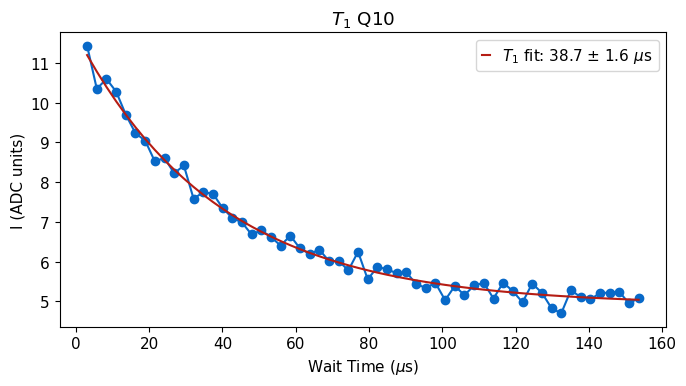

*Set cfg qubit 10 T1 to 38.73 from 42.14*
*Set cfg readout 10 final_delay to 232.36 from 209.48*
{}


  0%|          | 0/27000 [00:00<?, ?it/s]

R2:0.948	Fit par error:0.051	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\echo_qubit10_00104.h5


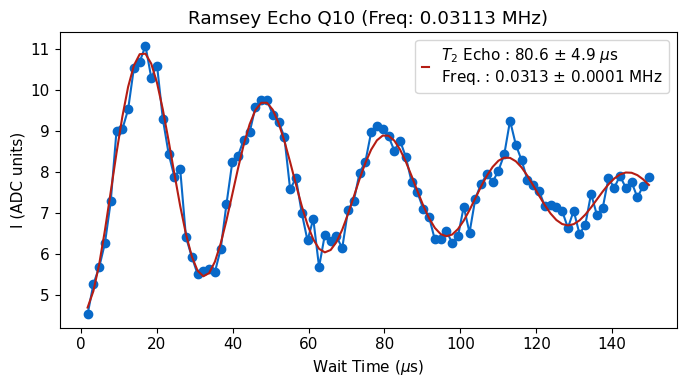

*Set cfg qubit 10 T2e to 80.6 from 50.46*


  0%|          | 0/27000 [00:00<?, ?it/s]

R2:0.932	Fit par error:0.050	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\echo_qubit10_00105.h5


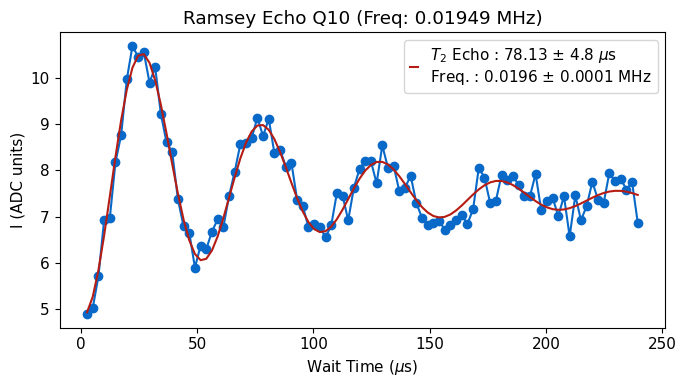

*Set cfg qubit 10 T2e to 78.13 from 80.6*


  0%|          | 0/5 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_chi_fine_qubit10_00014.h5


  0%|          | 0/2 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_fine_qubit10_00080.h5


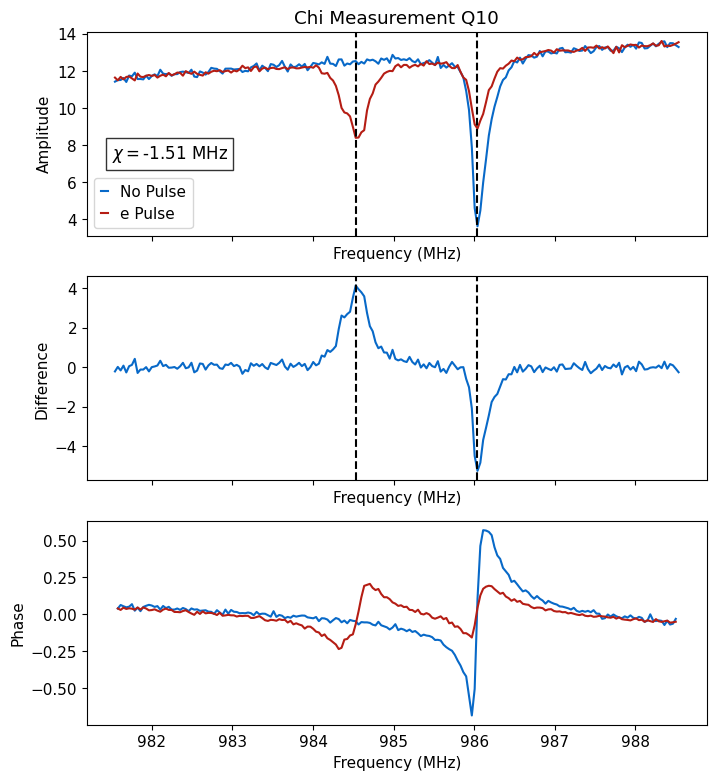

*Set cfg readout 10 chi to -1.5123 from -1.4771*


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


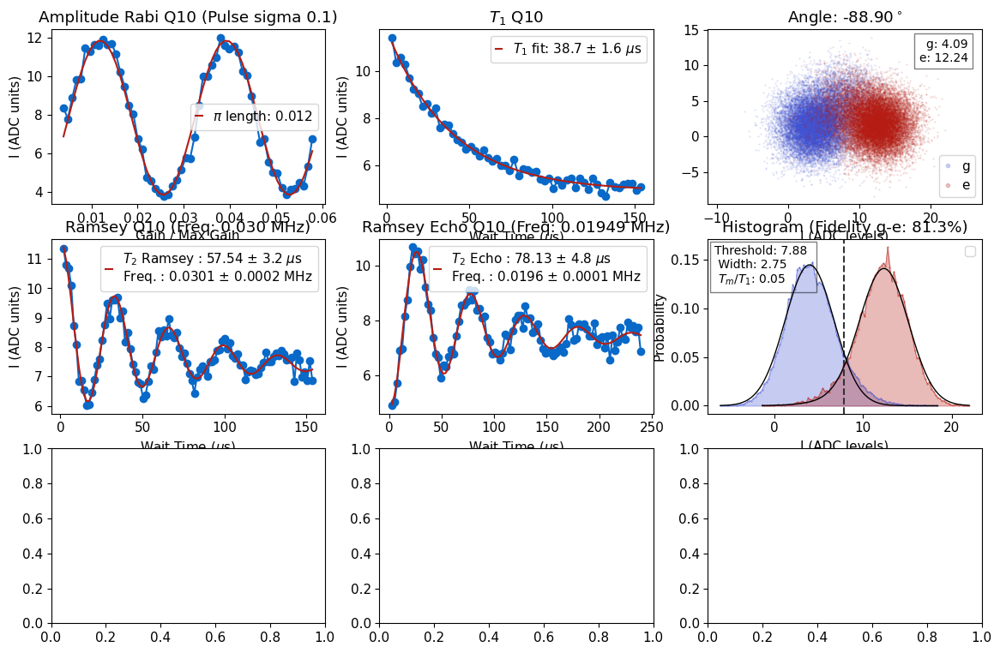

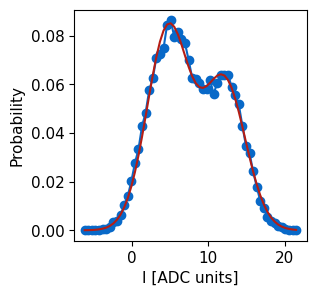

ge Fidelity (%): 81.270
Rotation angle (deg): -88.895
Threshold ge: 7.879
C:\_Data\LLotsa\Tuning_2025_01_11\images\summary\qubit10_tuneup_20250220_1532.png


In [431]:
# qubit_list = np.arange(0,5)
qubit_list=[10]
plt.rcParams.update({'font.size': 11})
for qi in qubit_list: 
    qubit_tuning.tune_up_qubit(qi, cfg_dict, first_time=False, single=False, readout = True)

### Check how gain * sigma varies across qubits

In [ ]:
auto_cfg = config.load(cfg_path)
plt.figure()
gain_proxy = np.array(auto_cfg.device.qubit.pulses.pi_ge.gain)*np.array(auto_cfg.device.qubit.pulses.pi_ge.sigma)
gain_proxy1 = gain_proxy[0:10]
gain_proxy2 = gain_proxy[10:]
gain_proxy[gain_proxy>0.1]=np.nan
#plt.plot(np.array(auto_cfg.device.qubit.f_ge)[inds], gain_proxy[inds], 'o')

plt.plot(np.array(auto_cfg.device.qubit.f_ge)[0:10], gain_proxy1, 'o')
plt.plot(np.array(auto_cfg.device.qubit.f_ge)[10:], gain_proxy2, 'o')

## Rabi

### Amplitude

  0%|          | 0/8940 [00:00<?, ?it/s]

R2:0.979	Fit par error:0.019	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi__qubit10_00101.h5


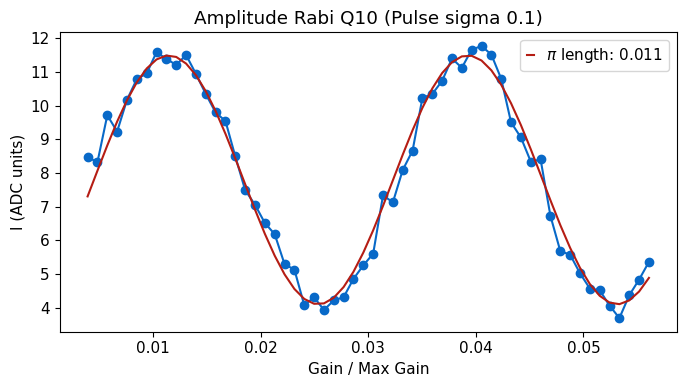

*Set cfg qubit 10 ('pulses', 'pi_ge', 'gain') to 0.0114 from 0.0115*
*Set cfg qubit 10 ('pulses', 'pi_ge', 'sigma') to 0.1 from 0.1*


In [430]:
# qubit_list = np.arange(11,20)
qubit_list=[10]
pulse_len = 0.1

update=True

for qi in qubit_list: 
    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params = {'sigma':pulse_len})
#    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'active_reset':True, 'gain':0.25,'freq':4370, 'reps':1000,'soft_avgs':3,'pulse_type':'const','sigma':1})

    if update and amp_rabi.status:
        config.update_qubit(cfg_path, ('pulses','pi_ge','gain'), amp_rabi.data['pi_length'], qi)
        config.update_qubit(cfg_path,('pulses','pi_ge','sigma'), pulse_len,qi)

#### Chevron

  0%|          | 0/30 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_chevron__qubit0_00008.h5


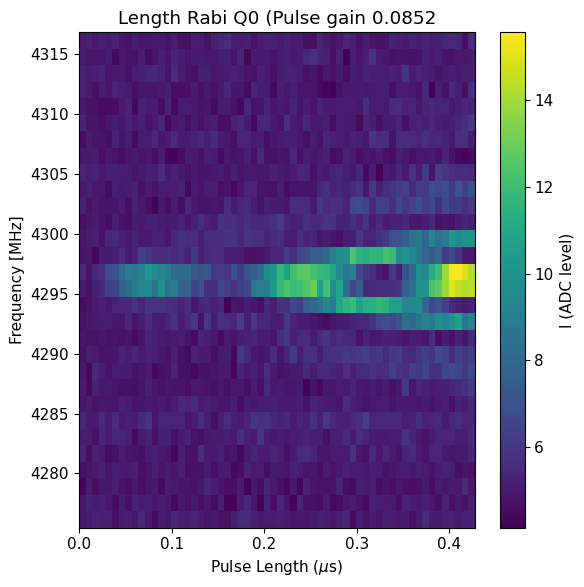

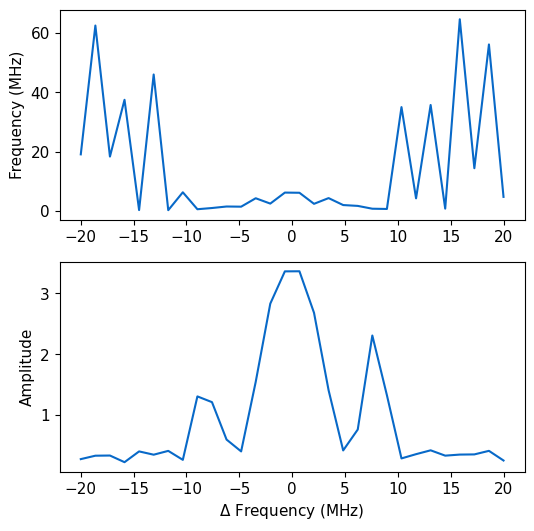

In [363]:
d2=[]
qubit_list = np.arange(11,20)
# Fix ; doing length rabi by default, plotting error 
qubit_list=[0]
for qi in qubit_list: 
    amp_rabi_chevron = meas.RabiChevronExperiment(cfg_dict,qi=qi, params={'span_f':40})
    d2.append(amp_rabi)
#handy.plot_many(d2, title='Rabi Chevron Phase', save_path=cfg_dict['expt_path'], chan='phases')

#### 2 Qubit Rabi

  0%|          | 0/8940 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


R2:0.990	Fit par error:0.001	 Best fit:b'avgi'
R2:0.753	Fit par error:0.184	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_Q0_Q10_00002.h5


KeyError: 'bin_centers'

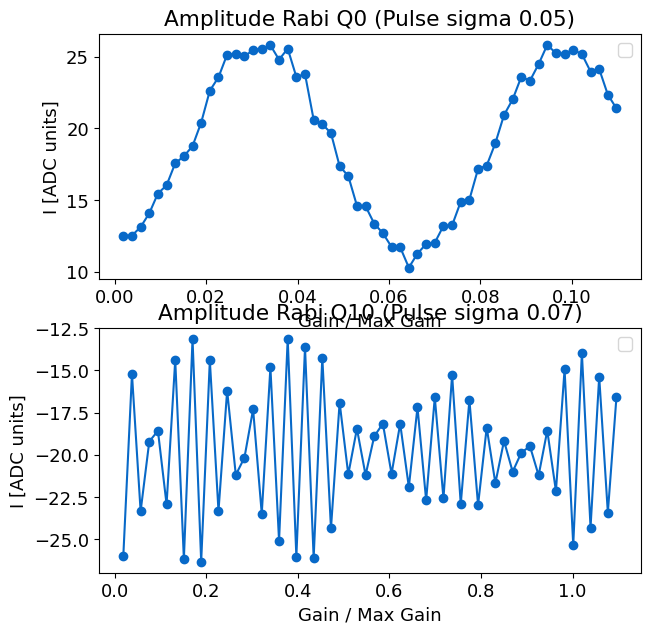

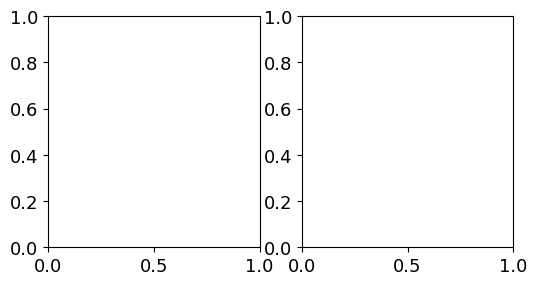

In [9]:
qi=[0,10]
amp_rabi = meas.Rabi_2Q(cfg_dict,qi=qi, params={'active_reset':False})

### Length -- Not working!!

In [139]:
len_rabi.data['pi_length']

0.11319667174356055

  0%|          | 0/8940 [00:00<?, ?it/s]

R2:0.983	Fit par error:0.010	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi__qubit10_00090.h5


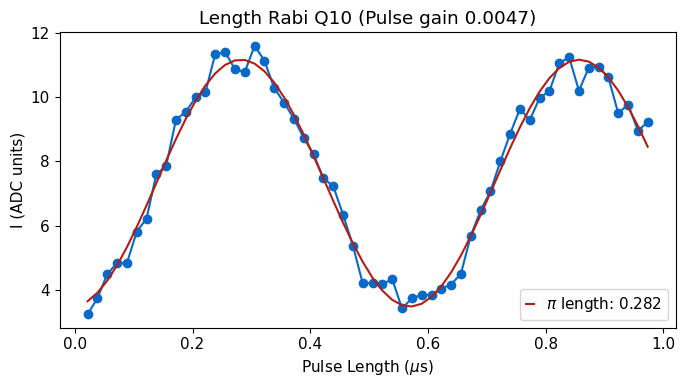

*Set cfg qubit 10 ('pulses', 'pi_ge', 'sigma') to 0.2822 from 0.3775*


In [216]:
qubit_list = [10]
update=True
# This does not work with gaussian pulses due to multiplying qickparams issues -- need to fix
#qubit_list=[3]
for qi in qubit_list: 
    len_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'sweep':'length', 'type':'const', 'sigma':1})
    if update and len_rabi.status:
       config.update_qubit(cfg_path, ('pulses','pi_ge','sigma'), len_rabi.data['pi_length'], qi) 
    

#### Chevron

In [ ]:
qubit_list = np.arange(20)
#qubit_list=[8]
for qi in qubit_list: 
    len_rabi = meas.RabiChevronExperiment(cfg_dict,qi=qi, params={'sweep':'length',"type":"const", 'sigma':0.205, 'expts_f':60, 'span_f':150, 'gain':0.4,'start_f':6280,'soft_avgs':4})

## Ramsey

  0%|          | 0/27000 [00:00<?, ?it/s]

R2:0.661	Fit par error:0.479	 Best fit:b'avgi'
Possible errors are 0.000 and 0.177 for Ramsey frequency 0.089 MHz
Saving C:\_Data\LLotsa\Tuning_2025_01_11\ramsey_qubit0_00158.h5


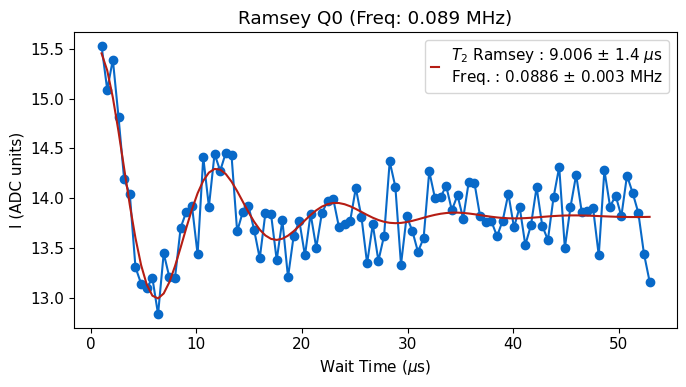

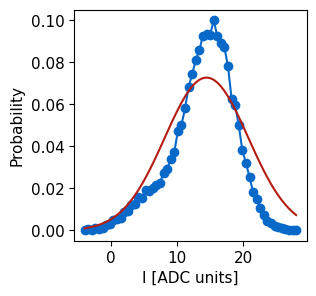

*Set cfg qubit 0 f_ge to 4296.223 from 4296.2228*
*Set cfg qubit 0 T2r to 9.01 from 17.69*


In [388]:
step = soc.cycles2us(1)
span = 40
expts = min(int(span/step),100)
qubit_list=[0,]
update = True
for qi in qubit_list:
    t2r = meas.RamseyExperiment(cfg_dict, qi=qi, max_err=10, params = {'ramsey_freq':'smart'})
    #t2r = meas.RamseyExperiment(cfg_dict, qi=qi, max_err=10, params = {'ramsey_freq':0.1,'expts':expts, 'span':span })
    if t2r.status and update:
        config.update_qubit(cfg_path, 'f_ge', t2r.data['new_freq'], qi)
        auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['best_fit'][3], qi, rng_vals=[1.5, max_t1], sig=2)
    else:
        print('T2 Ramsey fit failed')

### Use Ramsey to recenter

In [ ]:
qubit_list = [2]
for qi in qubit_list:
    status = qubit_tuning.recenter(qi,cfg_dict)            

### Ramsey coherence

In [ ]:
t1= qubit_tuning.get_coherence(meas.RamseyExperiment, qi, cfg_dict,par='T2r')

## T1

  0%|          | 0/16200 [00:00<?, ?it/s]

R2:0.988	Fit par error:0.028	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit0_00136.h5


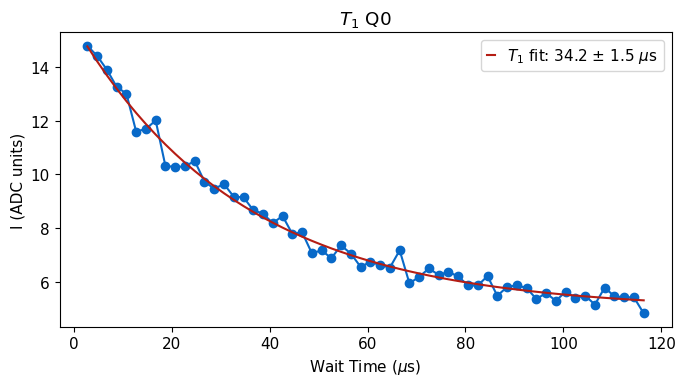

*Set cfg qubit 0 T1 to 34.23 from 31.79*
*Set cfg readout 0 final_delay to 205.38 from 190.76*


In [346]:
qubit_list = [0]
# If it's the first time, also set T2r and T2e as guesses 
update=True
first_time=False
for qi in qubit_list:
    t1 = meas.T1Experiment(cfg_dict, qi=qi)
    if update and t1.status: 
        auto_cfg = config.update_qubit(cfg_path, 'T1', t1.data['new_t1_i'], qi,sig=2, rng_vals=[1.5, max_t1*2])
        auto_cfg = config.update_readout(cfg_path, 'final_delay', 6*t1.data['new_t1'], qi, sig=2,rng_vals=[10, 1000])
        if first_time:
            auto_cfg = config.update_qubit(cfg_path, 'T2r', t1.data['new_t1_i'], qi,sig=2, rng_vals=[1.5, max_t1*2])
            auto_cfg = config.update_qubit(cfg_path, 'T2e', 2*t1.data['new_t1'], qi,sig=2, rng_vals=[1.5, max_t1*2])

### T1 coherence

{}


  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.995	Fit par error:0.015	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit0_00125.h5


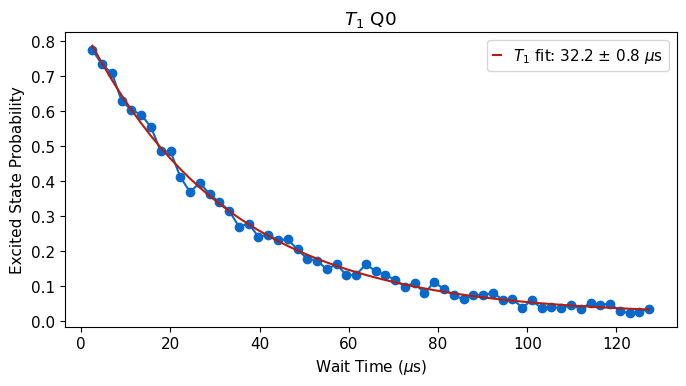

*Set cfg qubit 0 T1 to 32.23 from 34.94*


In [264]:
qi=0
qubit_tuning.get_coherence(meas.T1Experiment,qi=qi,cfg_dict=cfg_dict,par='T1')

{}


  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.985	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00120.h5


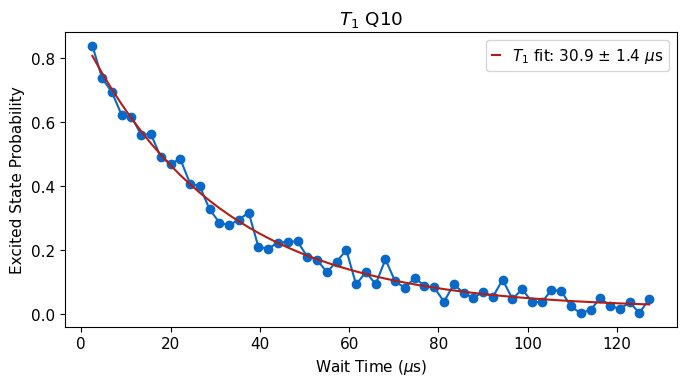

*Set cfg qubit 10 T1 to 30.92 from 34.91*


In [265]:
qi=10
qubit_tuning.get_coherence(meas.T1Experiment,qi=qi,cfg_dict=cfg_dict,par='T1')

## Continuous scan at single point

  0%|          | 0/50000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_cont_qubit0_00013.h5


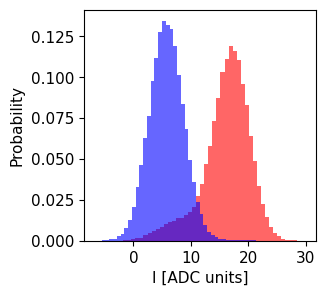

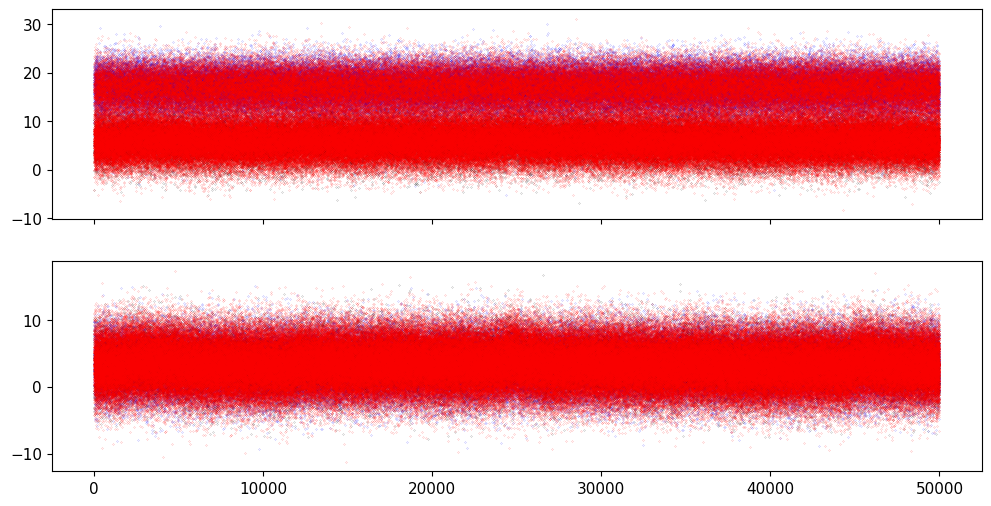

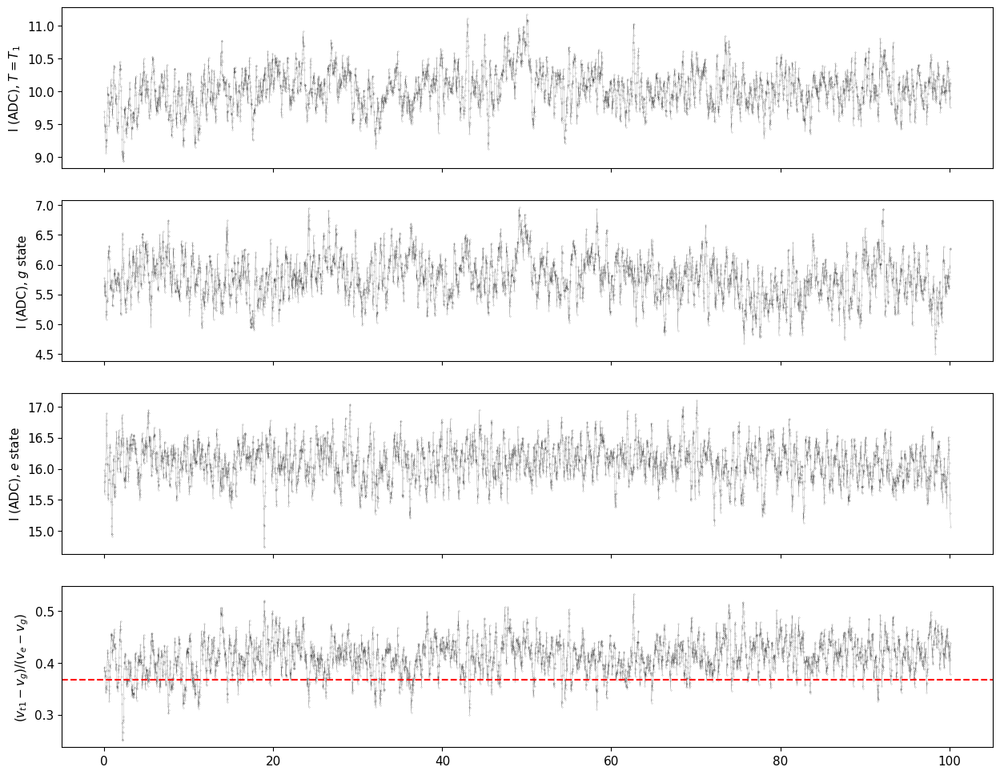

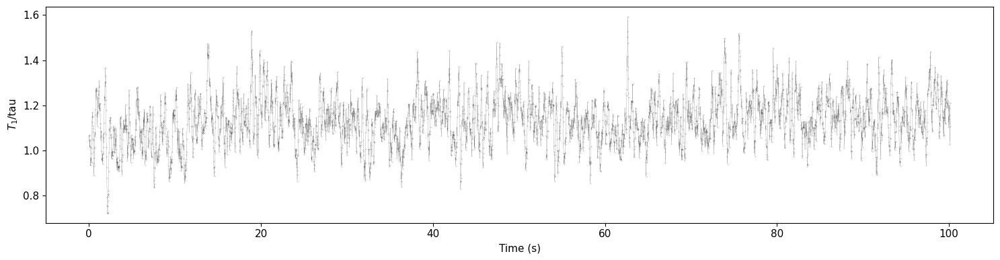

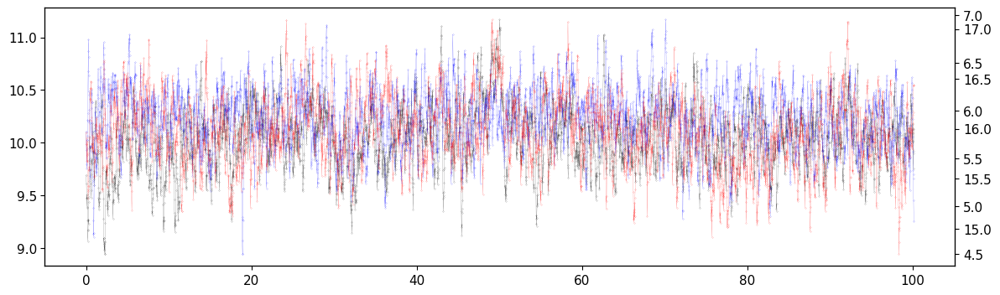

In [318]:
qi=0
#cProfile.run('meas.T1ContExperiment(cfg_dict,qi=qi, params={"shots":1000})')
meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':50000})

  0%|          | 0/100000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_cont_qubit10_00003.h5


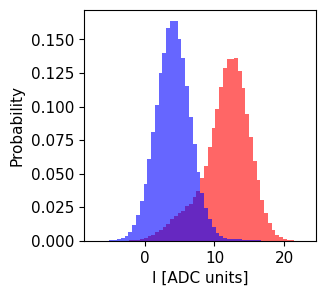

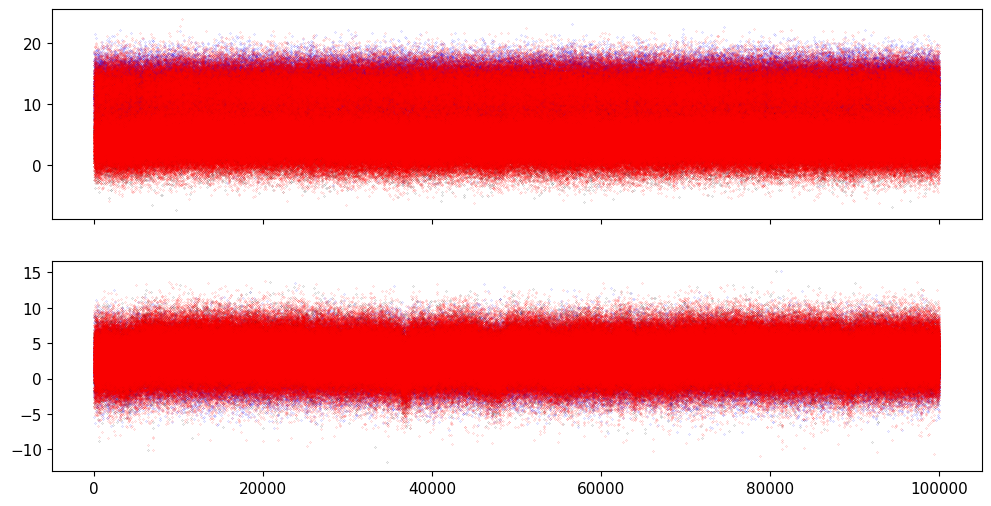

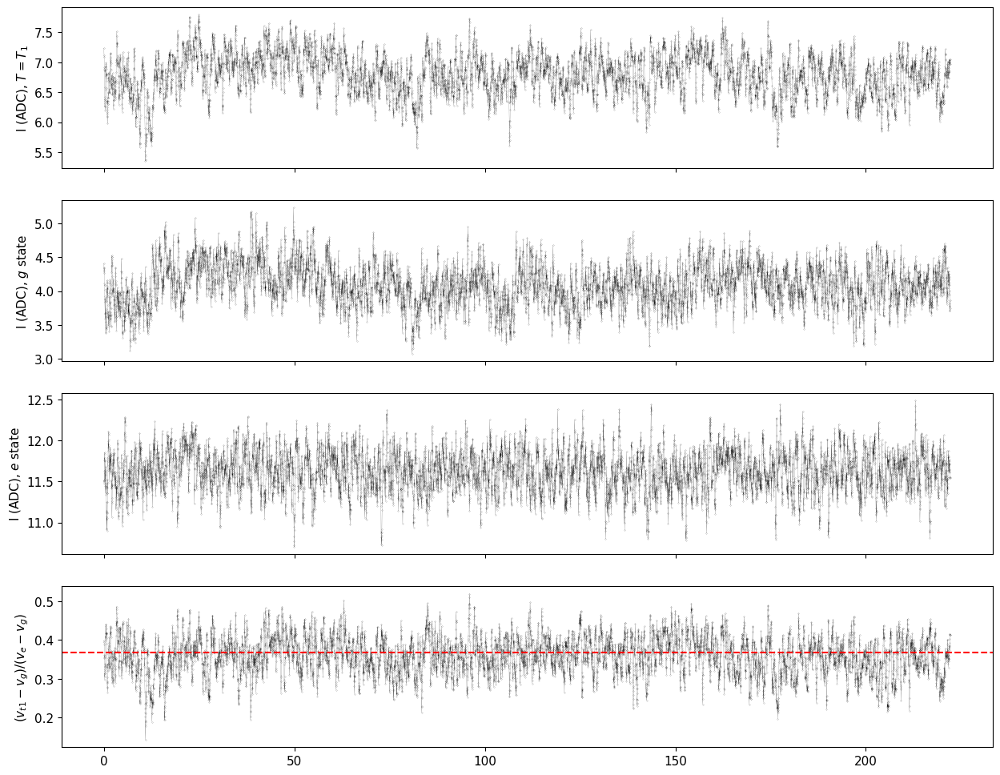

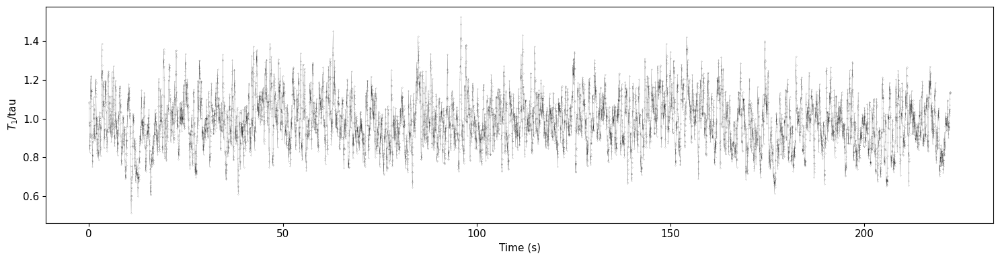

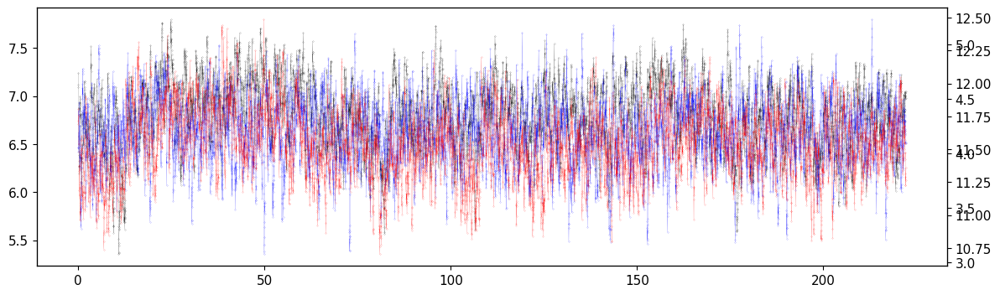

In [259]:
import cProfile

qi=10
#cProfile.run('meas.T1ContExperiment(cfg_dict,qi=qi, params={"shots":1000})')
meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':100000, 'active_reset':False})

  0%|          | 0/17280 [00:00<?, ?it/s]

R2:0.974	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit0_00110.h5


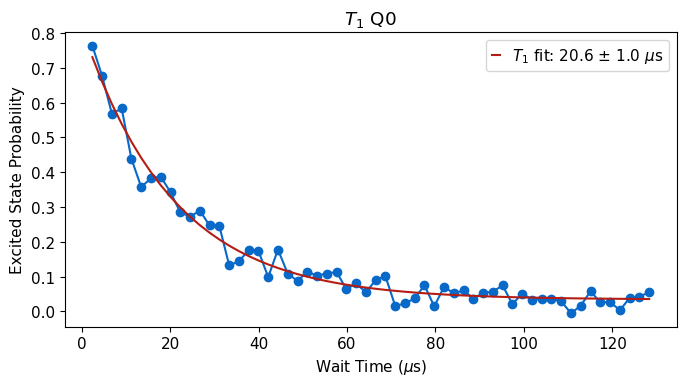

In [29]:
meas.T1Experiment(cfg_dict, qi = 0)

  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.990	Fit par error:0.023	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_qubit10_00104.h5


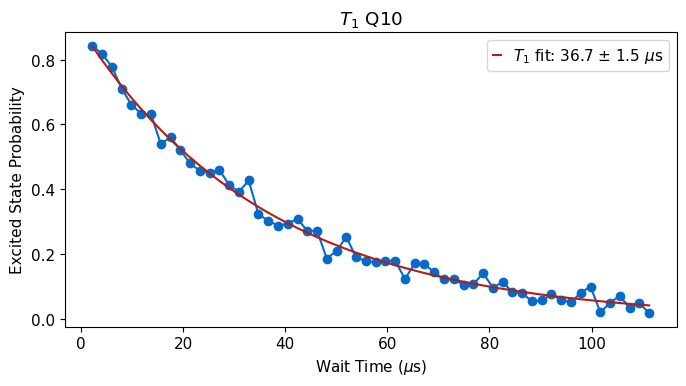

In [25]:
meas.T1Experiment(cfg_dict, qi = 10)

## T1 continuous 2Q

  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.997	Fit par error:0.002	 Best fit:b'avgi'
R2:0.996	Fit par error:0.004	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q10_Q0_00021.h5
('Error in saving cfg into datafile (experiment.py):', TypeError('Object of type bool_ is not JSON serializable'))


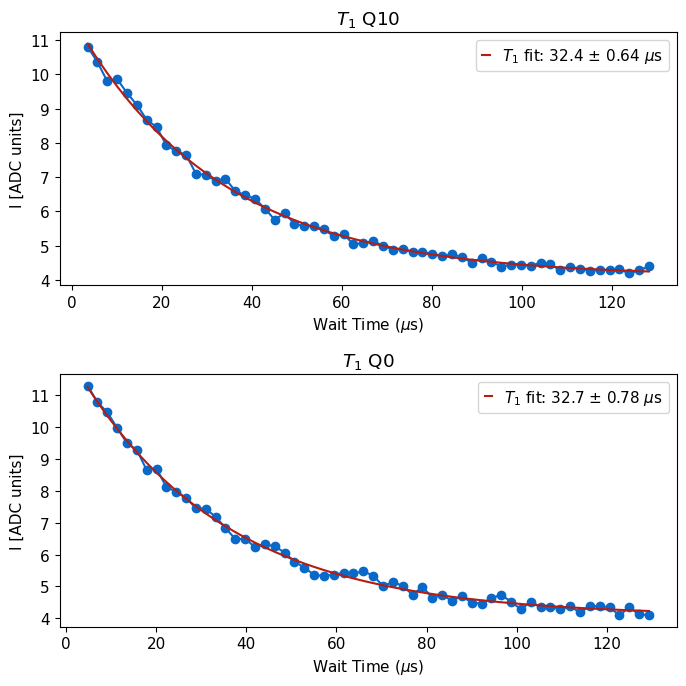

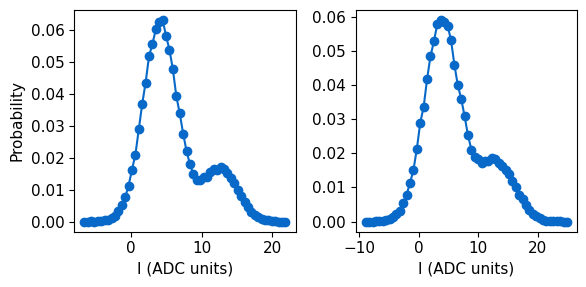

In [262]:
qi = [10,0]
meas.T1_2Q(cfg_dict,qi=qi, )

  0%|          | 0/69240 [00:00<?, ?it/s]

R2:0.995	Fit par error:0.003	 Best fit:b'avgi'
R2:0.996	Fit par error:0.003	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q0_Q10_00013.h5
('Error in saving cfg into datafile (experiment.py):', TypeError('Object of type bool_ is not JSON serializable'))


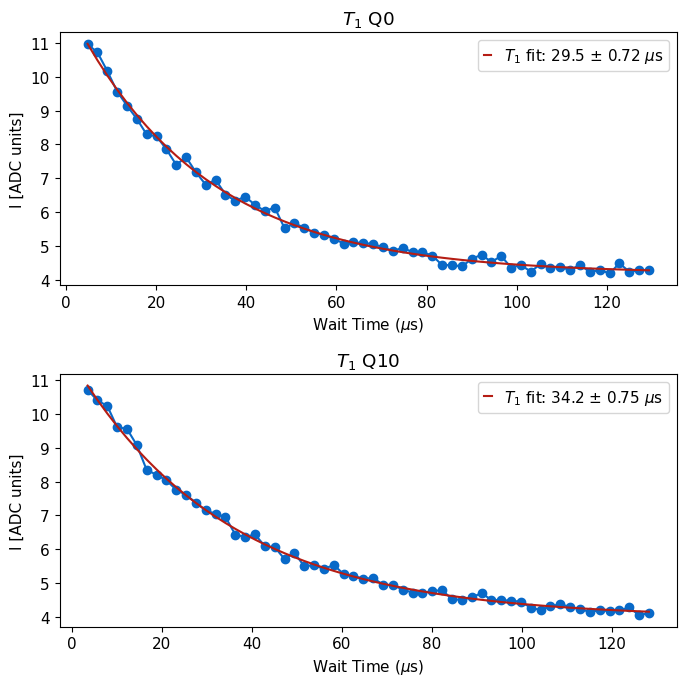

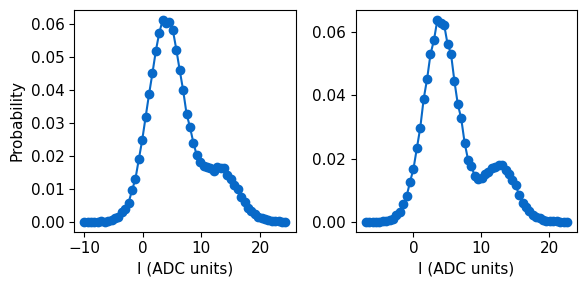

In [263]:
### T1 coherence

# from experiments.two_qubit.t1_2q import T1_2Q_Continuous
qi = [0,10]
meas.T1_2Q(cfg_dict,qi=qi, )
# meas.T1ContExperiment(cfg_dict,qi=qi, params={'shots':100000})

In [22]:
import experiments as meas

150000


  0%|          | 0/150000 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_cont_Q0_Q10_00058.h5


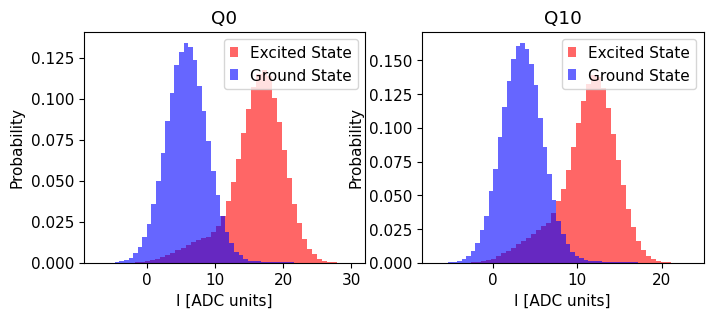

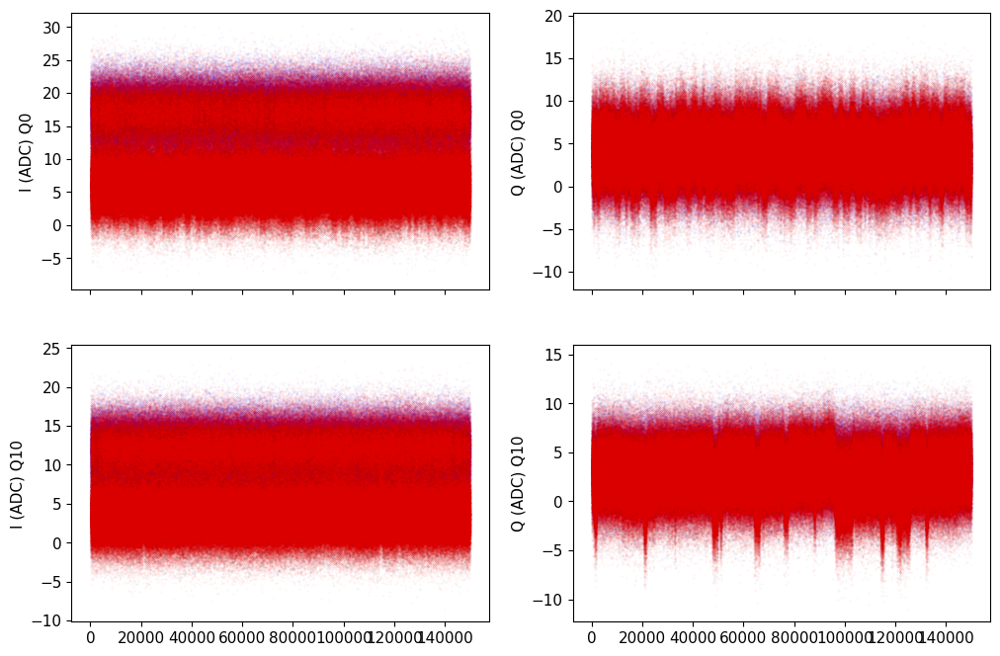

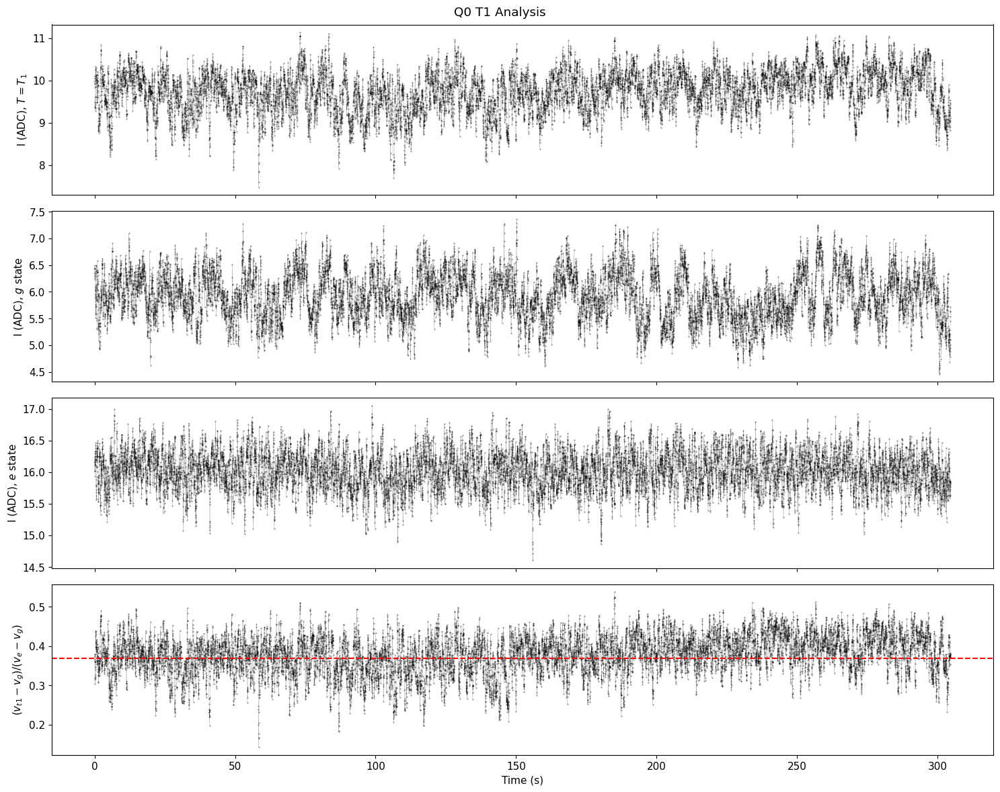

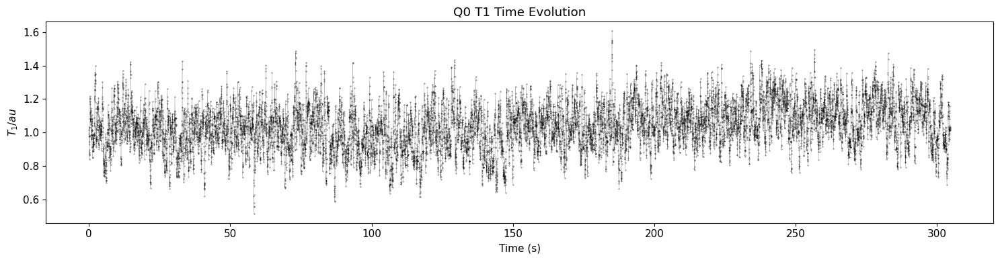

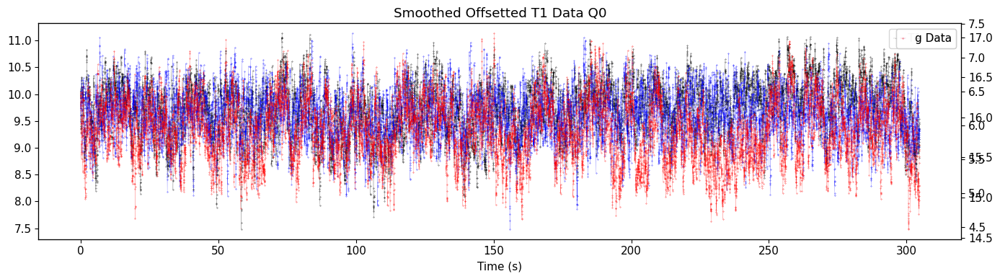

...

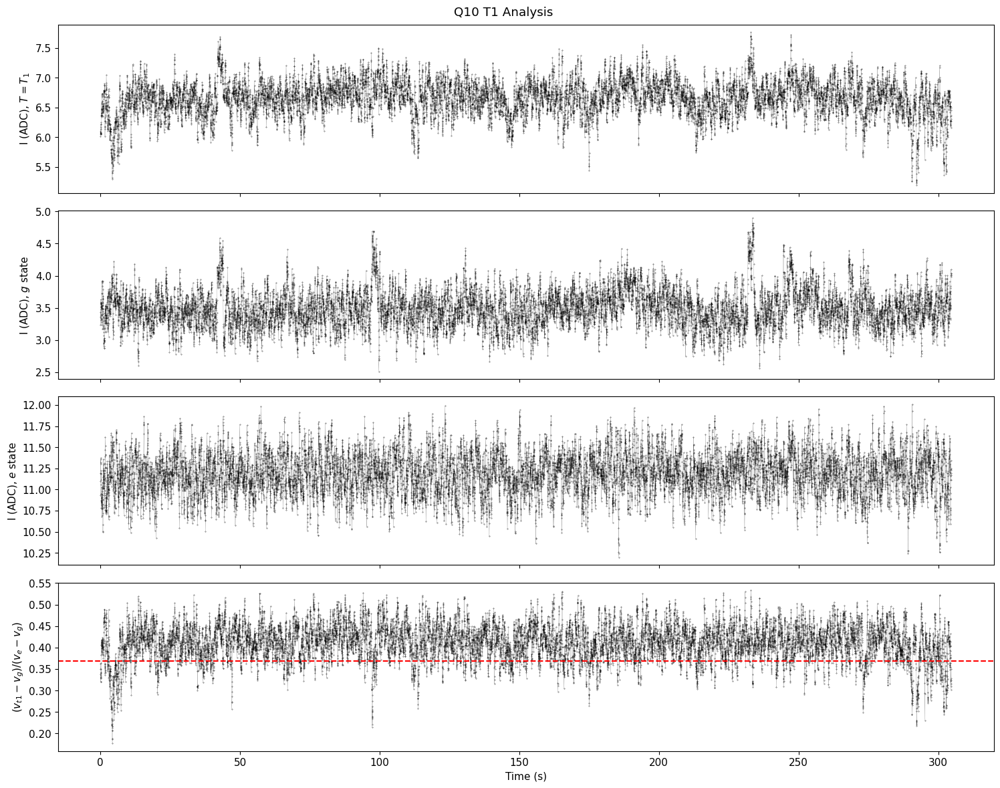

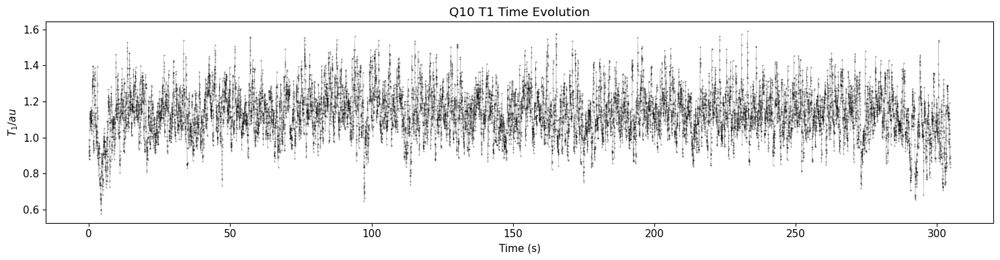

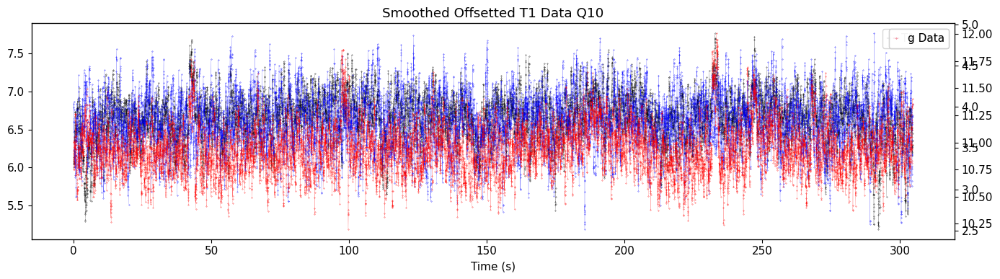

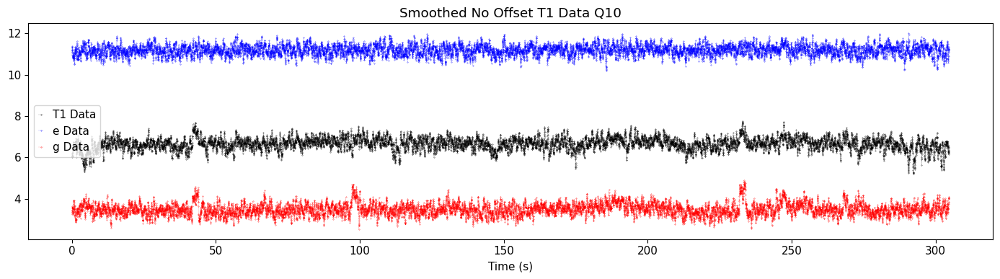

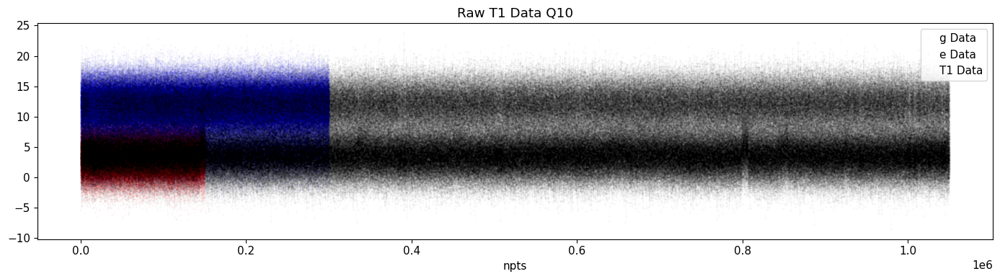

In [330]:
qi=[0,10]
scan_time = 0.1 #hours
number_of_scans = 1
shots = int(100000*scan_time*60/4)
print(shots)
for i in range(number_of_scans):
    meas.T1Cont2QExperiment(cfg_dict,qi=qi, params={'shots':shots, 'active_reset':False})
    # for q in qi:
    #     shot=meas.HistogramExperiment(cfg_dict, qi=q, params={'shots':20000})
    #     config.update_readout(cfg_path, 'phase', shot.data['angle'], q);
    #     config.update_readout(cfg_path, 'threshold',shot.data['thresholds'][0], q);
    #     config.update_readout(cfg_path, 'fidelity', shot.data['fids'][0], q);
    #     config.update_readout(cfg_path, 'sigma', shot.data['sigma'], q);
    #     config.update_readout(cfg_path, 'tm', shot.data['tm'],q);

## Echo

  0%|          | 0/27000 [00:00<?, ?it/s]

R2:0.939	Fit par error:0.045	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\echo_qubit0_00114.h5


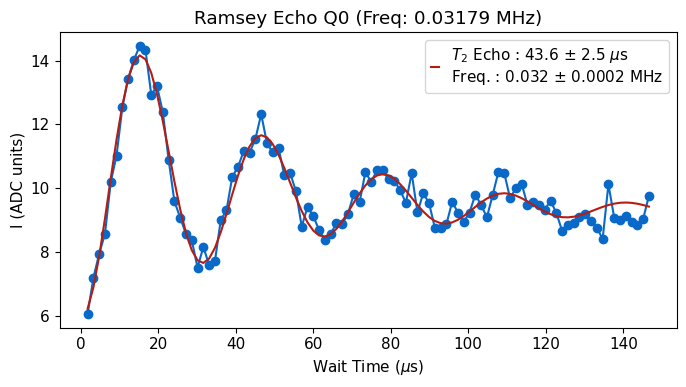

*Set cfg qubit 0 T2e to 43.6 from 49.41*


In [348]:
qubit_list = np.arange(20)
qubit_list=[0]
for qi in qubit_list:
    #status, t2e = tuneup.get_coherence(cfg.make_t2e, i, cfg_dict,'T2e', min_r2=min_r2,tol=tol, max_t1=max_t1)
    t2e = meas.RamseyEchoExperiment(cfg_dict, qi=qi, params={'ramsey_freq':'smart', 'soft_avgs':1})
    if t2e.status:
        auto_cfg = config.update_qubit(cfg_path, 'T2e', t2e.data['best_fit'][3], qi,sig=2, rng_vals=[1.5, max_t1*2])

### Get echo coherence

In [ ]:
qi=6
t2e = qubit_tuning.get_coherence(meas.RamseyEchoExperiment, qi, cfg_dict,'T2e')

## Feedback checks

In [ ]:
qi=10
reset = meas.MemoryExperiment(cfg_dict, qi=qi, params={'shots':1, 'expts':200})

  0%|          | 0/30000 [00:00<?, ?it/s]

  0%|          | 0/30000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00257.h5


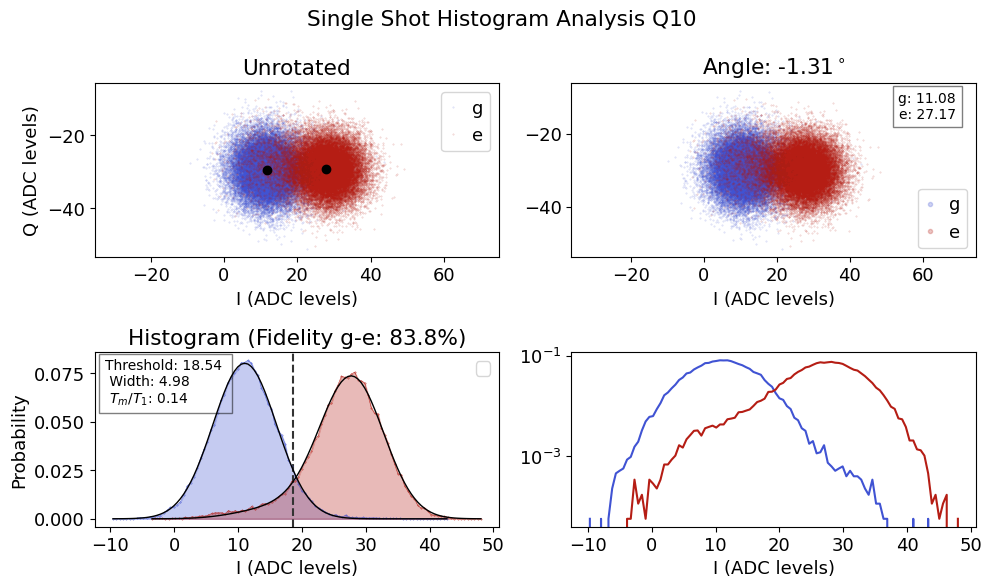

ge Fidelity (%): 83.833
Rotation angle (deg): -1.308
Threshold ge: 18.542
Reset is 0.340786 of e and 19.8981 of g


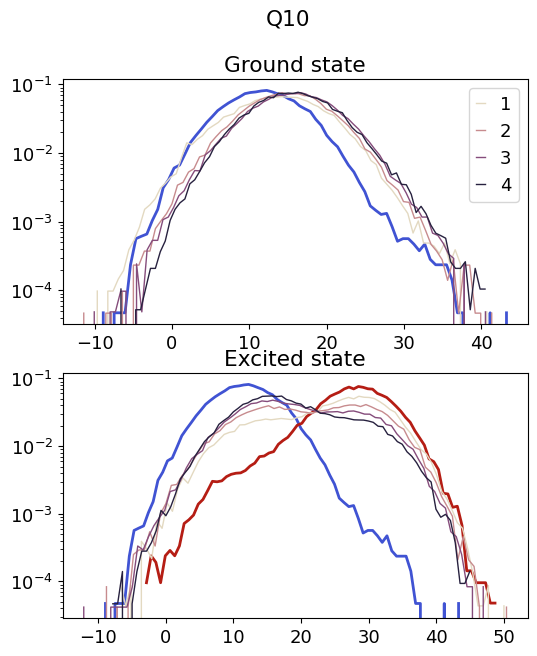

In [ ]:
# Don't do the active reset, just do the repeated measurement 
#shot=meas.RepMeasExperiment(cfg_dict, qi=qi, params={'shots':20000})
qi=1
shot = meas.RepMeasExperiment(cfg_dict, qi=qi, params={'shots':30000,'active_reset':True, 'setup_reset':True})
shot.check_reset()


# Single Shot

  0%|          | 0/20000 [00:00<?, ?it/s]

  0%|          | 0/20000 [00:00<?, ?it/s]

c:\_Lib\python\slab_qick_calib\experiments\single_qubit\single_shot.py:264: RuntimeWarning: overflow encountered in exp
  * np.exp(tm * (tm * sigma**2 / 2 / dv**2 - (v - vg) / dv))
c:\_Lib\python\slab_qick_calib\experiments\single_qubit\single_shot.py:261: RuntimeWarning: invalid value encountered in multiply
  tm
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_0_00287.h5


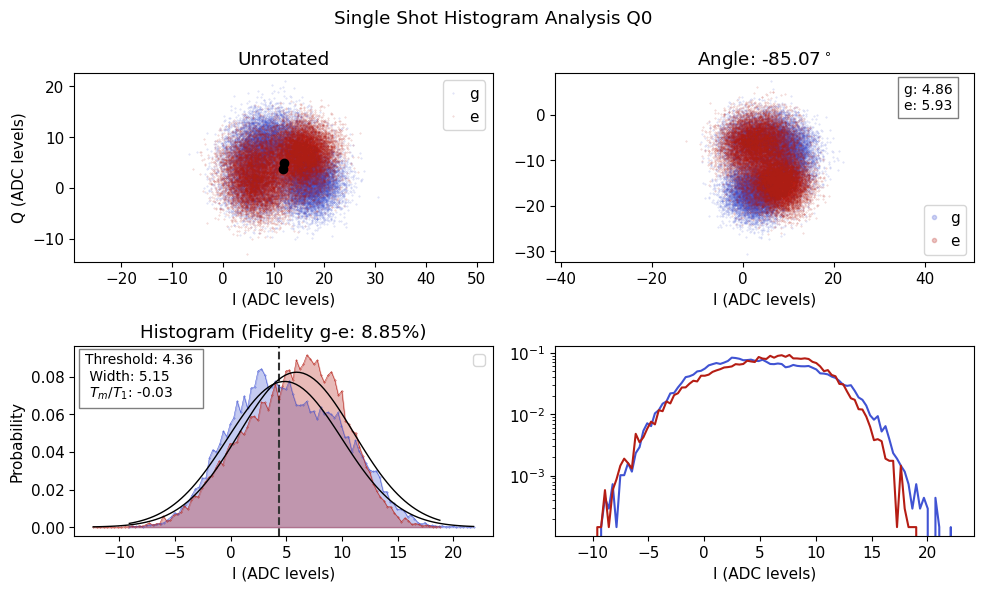

ge Fidelity (%): 8.848
Rotation angle (deg): -85.073
Threshold ge: 4.363
*Set cfg readout 0 phase to -85.0731 from -34.1649*
*Set cfg readout 0 threshold to 4.3628 from 12.3229*
*Set cfg readout 0 fidelity to 0.0885 from 0.3723*
*Set cfg readout 0 sigma to 5.1455 from 6.4793*
*Set cfg readout 0 tm to -0.0314 from -0.0401*


In [421]:
# Single shot 
# qubit_list = np.arange(0,20)
qubit_list =[0]
for qi in qubit_list:
    shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000})
    config.update_readout(cfg_path, 'phase', shot.data['angle'], qi);
    config.update_readout(cfg_path, 'threshold',shot.data['thresholds'][0], qi);
    config.update_readout(cfg_path, 'fidelity', shot.data['fids'][0], qi);
    config.update_readout(cfg_path, 'sigma', shot.data['sigma'], qi);
    config.update_readout(cfg_path, 'tm', shot.data['tm'],qi);

### Readout opt

#### General sweep

  0%|          | 0/5 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_opt_qubit_10_00022.h5
Max fidelity 87.410 %
Set params: 
 angle (deg) 104.205 
 threshold 6.701 
 freq [MHz] 986.041 
 Gain [DAC units] 0.099 
 readout length [us] 8.800


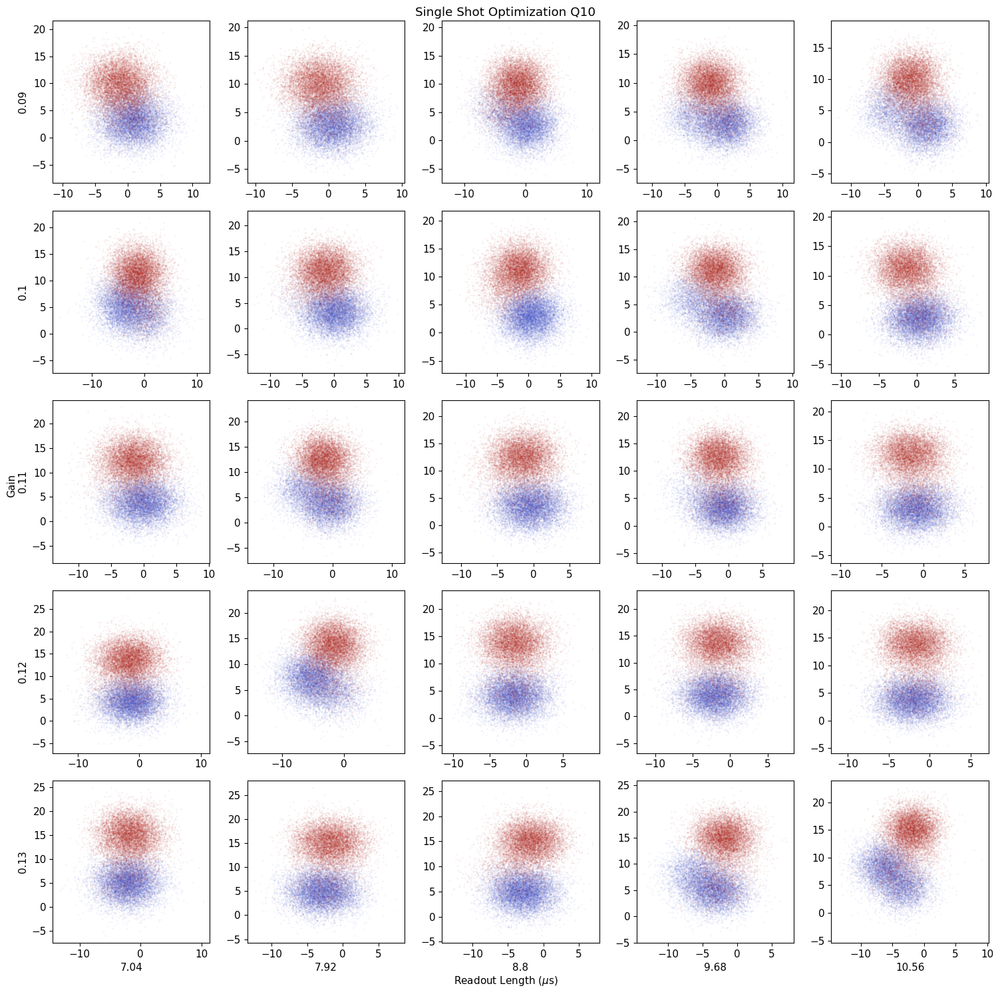

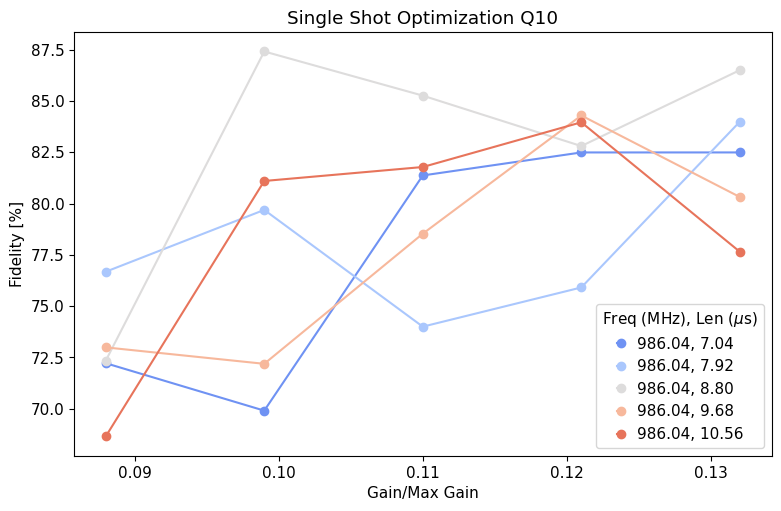

*Set cfg readout 10 gain to 0.099 from 0.11*
*Set cfg readout 10 readout_length to 8.8 from 8.8*
*Set cfg readout 10 frequency to 986.0407 from 986.0407*


In [433]:
qubit_list=np.arange(14,20)
qubit_list=[10]

update=True
params = {'expts_f':1, 'expts_gain':5, 'expts_len':5}
for qi in qubit_list: 
    shotopt=meas.SingleShotOptExperiment(cfg_dict, qi=qi,params=params,style='fine')
    if update:
        config.update_readout(cfg_path, 'gain', shotopt.data['gain'], qi);
        config.update_readout(cfg_path, 'readout_length', shotopt.data['length'], qi);
        config.update_readout(cfg_path, 'frequency', shotopt.data['freq'], qi);

#### Run optimization until it converges

  0%|          | 0/7 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_opt_qubit_10_00008.h5
Max fidelity 85.759 %
Set params: 
 angle (deg) 161.992 
 threshold 27.350 
 freq [MHz] 985.723 
 Gain [DAC units] 0.342 
 readout length [us] 2.912


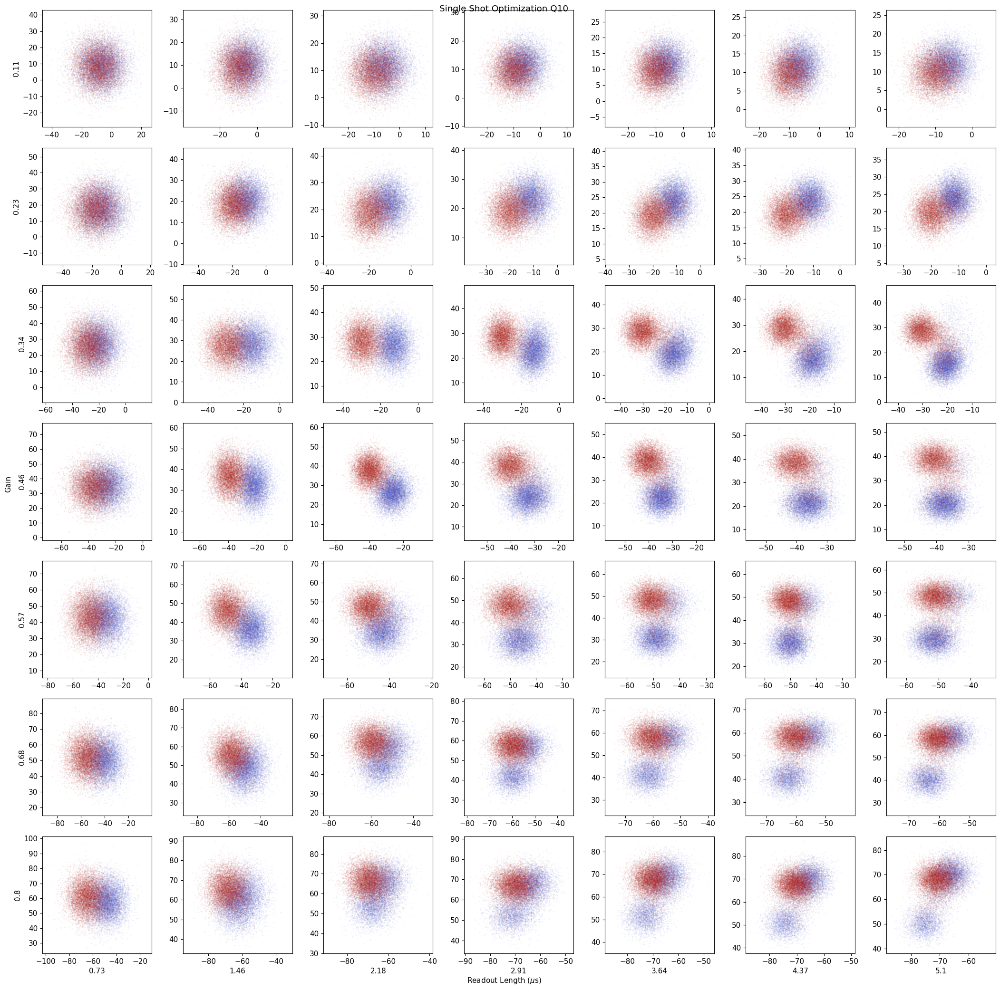

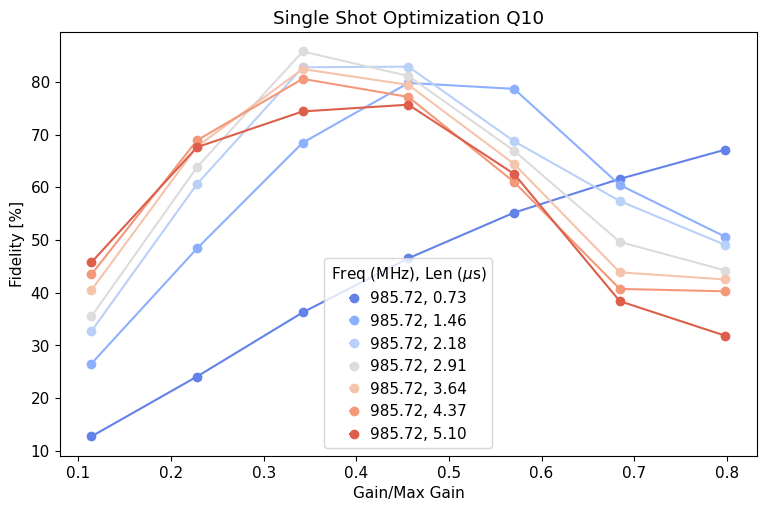

*Set cfg readout 10 gain to 0.3422 from 0.3802*
*Set cfg readout 10 readout_length to 2.9117 from 2.4264*


  0%|          | 0/7 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_opt_qubit_10_00009.h5
Max fidelity 86.459 %
Set params: 
 angle (deg) 156.225 
 threshold 34.226 
 freq [MHz] 985.723 
 Gain [DAC units] 0.388 
 readout length [us] 2.329


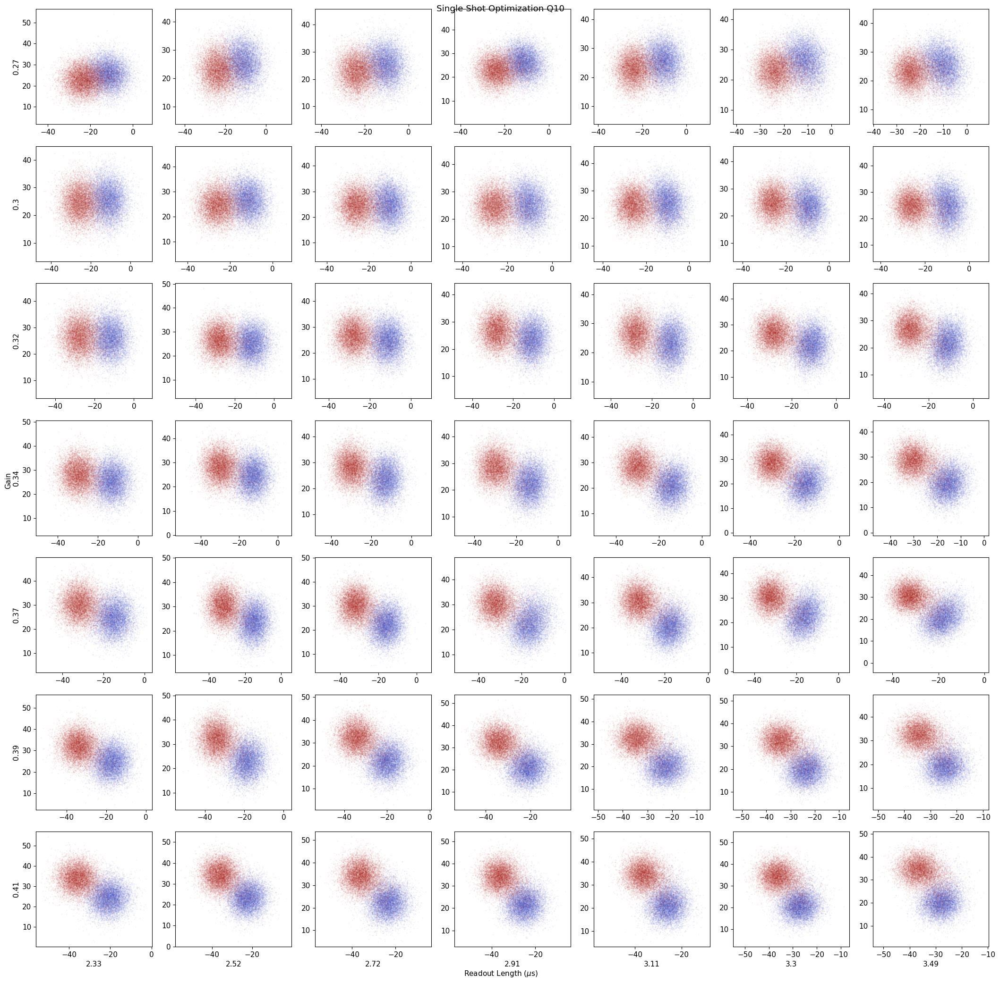

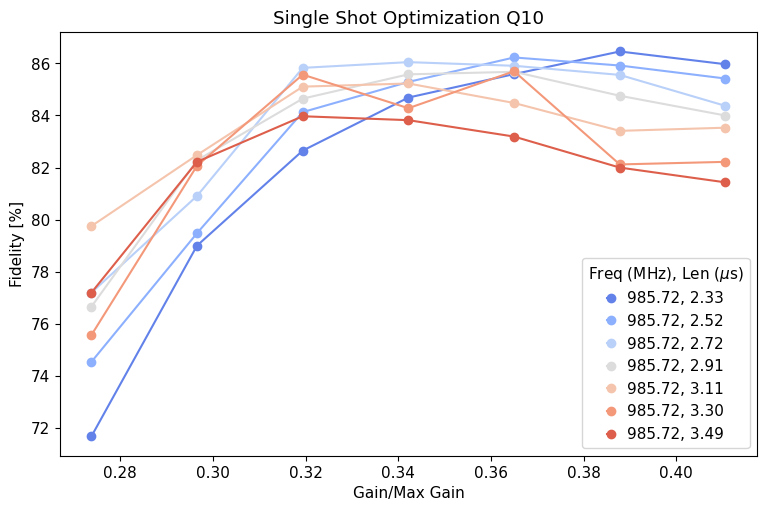

*Set cfg readout 10 gain to 0.3878 from 0.3422*
*Set cfg readout 10 readout_length to 2.3294 from 2.9117*


In [311]:
qubit_list=np.arange(7)
qubit_list=[10]
params = {'expts_f':1, 'expts_gain':7, 'expts_len':7}
qubit_tuning.meas_opt(cfg_dict, qubit_list, params)

#### Play with LO freq

In [ ]:
auto_cfg = config.load(cfg_path)
start_freq = auto_cfg.device.readout.frequency[qi]
start_mixer = auto_cfg.hw.soc.lo.mixer_freq[qi]
rng = np.linspace(-1000,1000,11)
for qi in qubit_list: 
    for r in rng: 
        config.update_lo(cfg_path, 'mixer_freq', start_mixer+r, qi)
        config.update_readout(cfg_path, 'frequency', start_freq-r, qi)
        shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000})

config.update_lo(cfg_path, 'mixer_freq', start_mixer, qi)
config.update_readout(cfg_path, 'frequency', start_freq, qi)

#### Play with LO power

In [ ]:
qi = 11
gain_vals = [0.0375,0.05] 
for gain in gain_vals:
    config.update_lo(cfg_path, 'gain', gain, qi)
    shotopt=meas.SingleShotOptExperiment(cfg_dict, qi=qi,params={'npts_f':5, 'npts_gain':5, 'npts_len':5})

### Adjust reps for fidelity 

In [313]:
max_inc = 15 # dont' let it do more than 15x standard number of reps sot hat thtings don't take forever
auto_cfg = config.load(cfg_path)
qubit_list = [10]
for qi in qubit_list:
    config.update_readout(cfg_path, 'reps', 1/auto_cfg['device']['readout']['fidelity'][qi]**1.5, qi, rng_vals=[1,max_inc]);

*Set cfg readout 10 reps to 1.2499 from 1.1902*


### Active reset

#### Check active reset at standard threshold

  0%|          | 0/100000 [00:00<?, ?it/s]

  0%|          | 0/100000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00387.h5


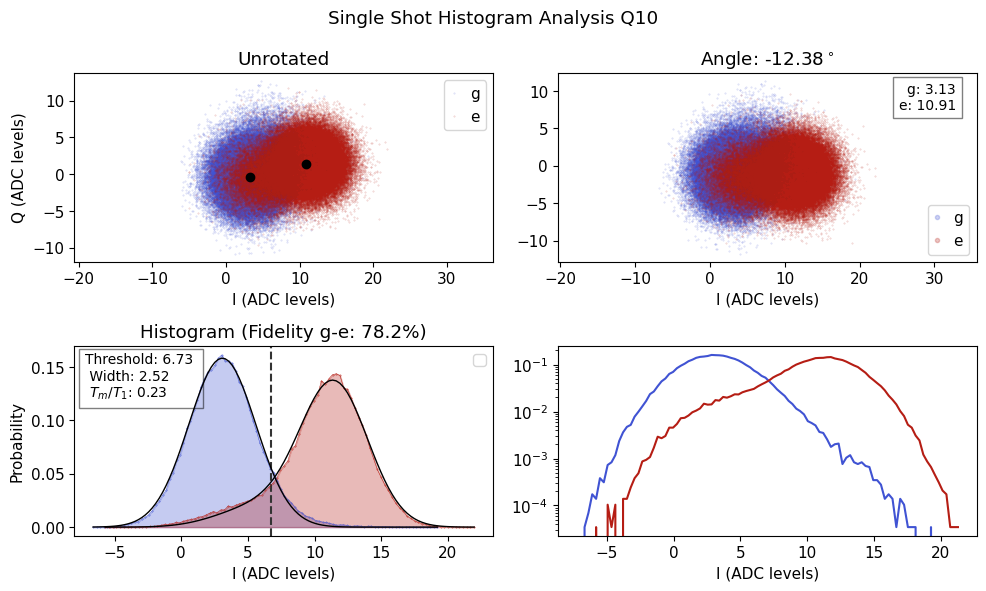

ge Fidelity (%): 78.235
Rotation angle (deg): -12.384
Threshold ge: 6.734
Reset is 0.0118252 of e and 0.514272 of g


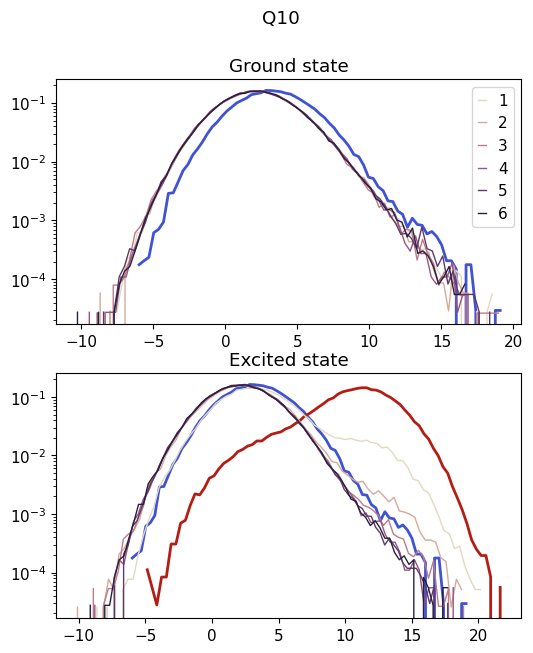

In [434]:
# Setup reset uses the calibrated angle and runs active reset process at end, but also uses usual final_delay so that it's ok if reset not working
qubit_list = np.arange(15,20)
qubit_list=[10]
d=[]
for qi in qubit_list:
    shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':100000,'active_reset':True, 'setup_reset':True})
    shot.check_reset()
    #config.update_readout(cfg_path, 'reset_e', shot.data['reset_e'], qi)
    #config.update_readout(cfg_path, 'reset_g', shot.data['reset_g'], qi)
    d.append(shot)

#### Sweep threshold

Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00303.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00304.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00305.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00306.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00307.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00308.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00309.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00310.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00311.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00312.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00313.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00314.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00315.h5
Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00316.h5
Saving

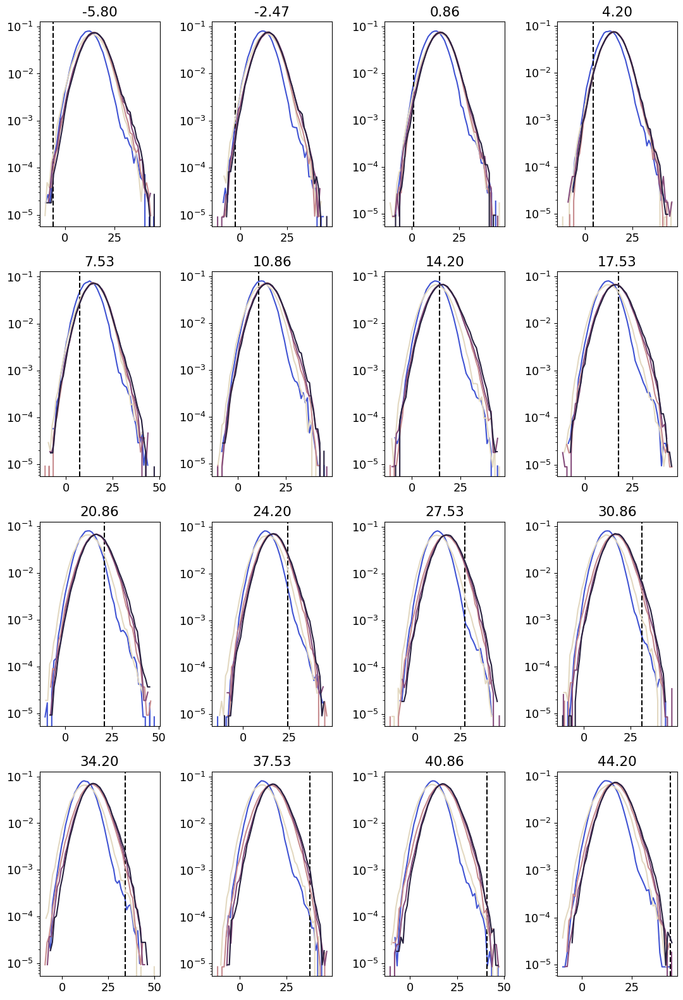

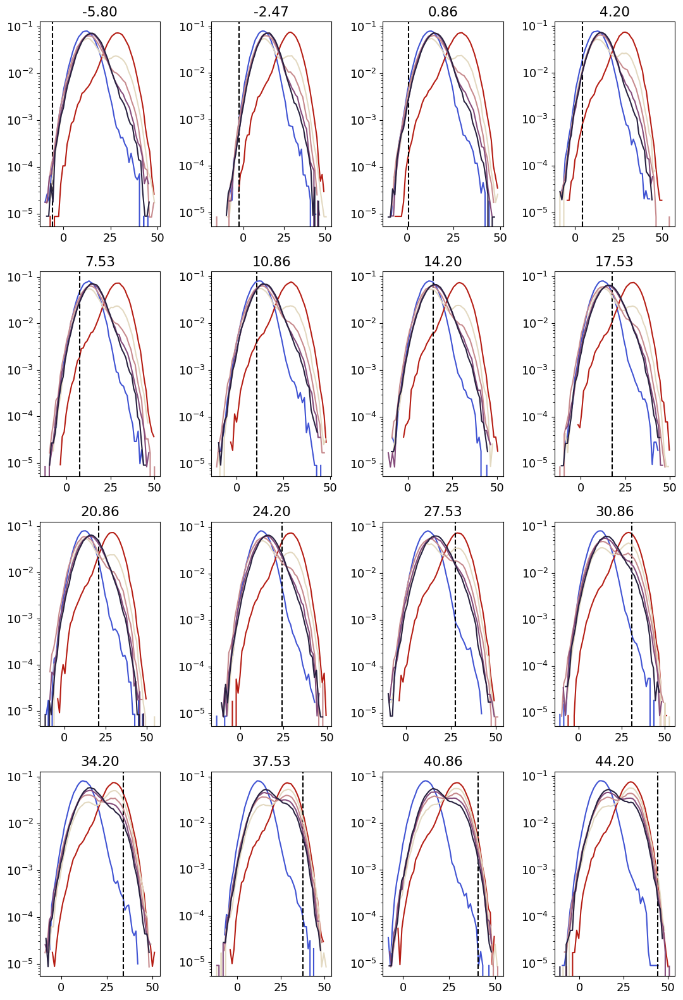

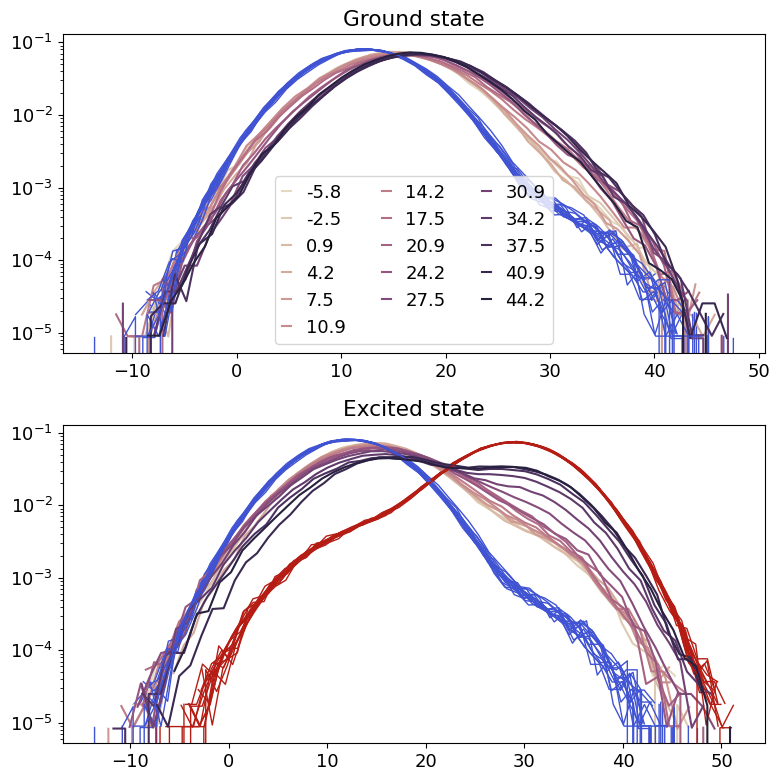

In [15]:
d = []
qi=10
auto_cfg = config.load(cfg_path)
threshold = auto_cfg['device']['readout']['threshold'][qi]
thresh = np.linspace(threshold-25,threshold+25,16)
#thresh = np.linspace(threshold-10,threshold+10,6)
for t in thresh:
    shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':100000,'threshold_v':t, 'active_reset':True,'setup_reset':True}, display=False, progress=False)
    d.append(shot)
    #shot.check_reset()
tuneup.plot_reset(d)

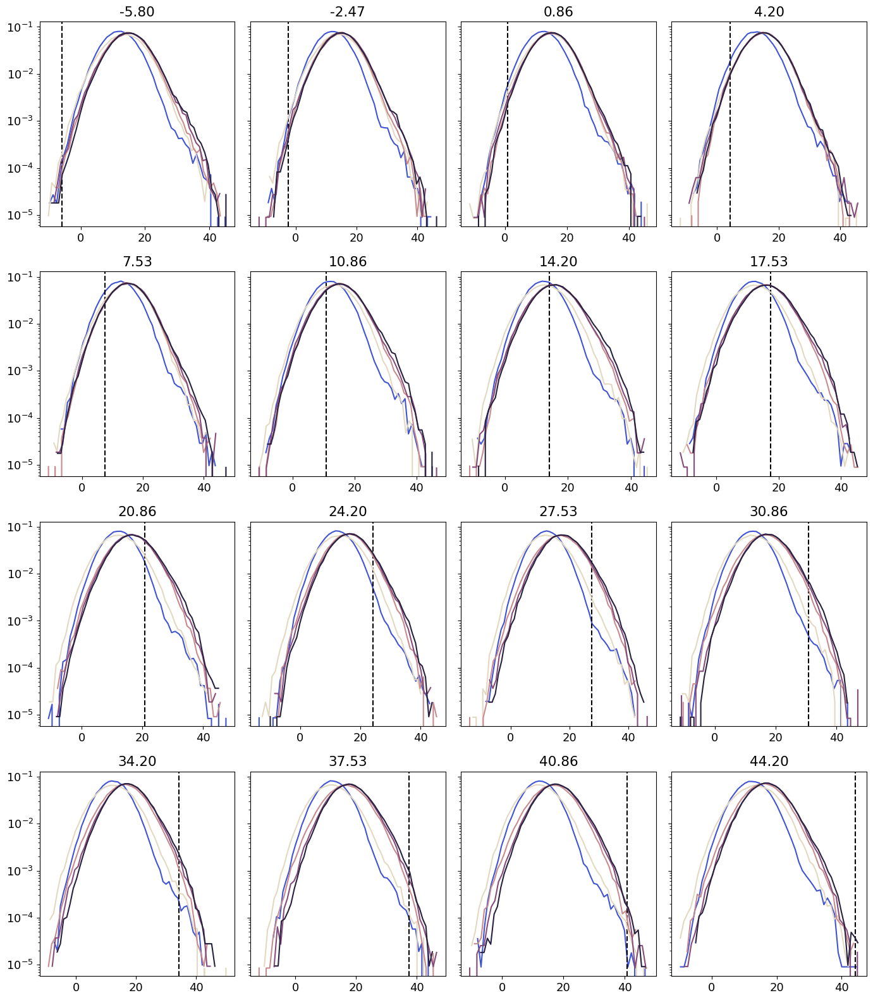

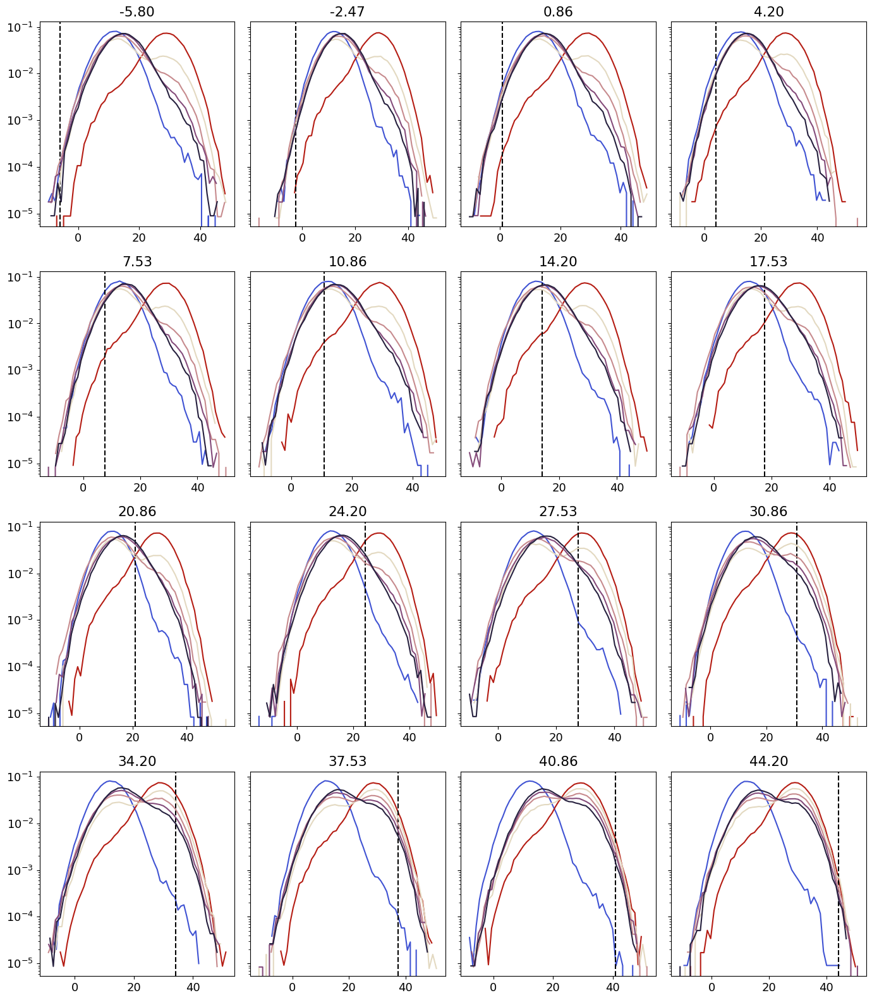

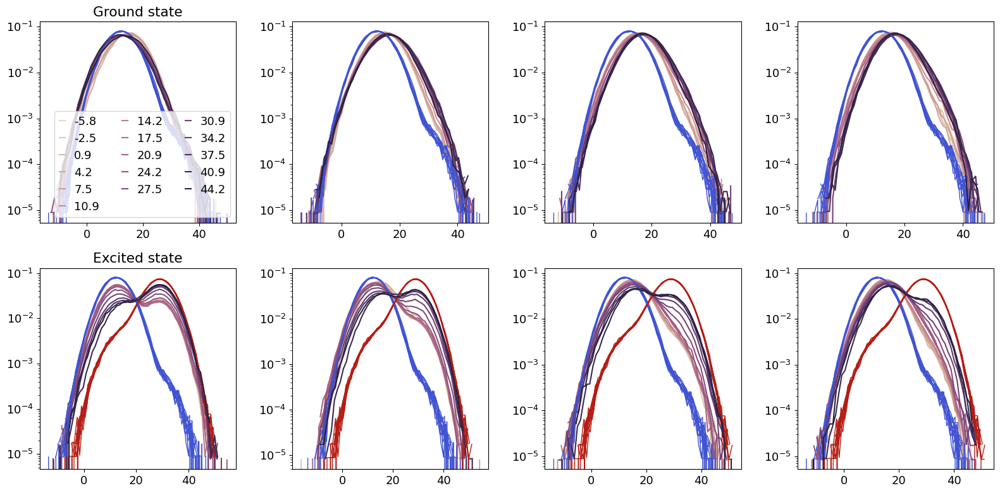

In [21]:
tuneup.plot_reset(d)

In [ ]:
# Check how many qubits meet certain thresholds for success of reset. 
reset_e = [d[i].data['reset_e'] for i in range(len(d))]
reset_g = [d[i].data['reset_g'] for i in range(len(d))]

plt.figure()
plt.semilogy(reset_e,'o')
plt.axhline(y=0.15, color='r', linestyle='--')
plt.semilogy(reset_g,'ro')
plt.semilogy(np.array(reset_g)/np.array(reset_e), 'ko')
plt.axhline(y=1, color='r', linestyle='--')
#plt.show()

#### Turn off active reset for all config chans

In [ ]:
for qi in range(20):
    config.update_readout(cfg_path, 'active_reset',False, qi)

In [436]:
config.update_readout(cfg_path, 'active_reset',True, 10);

*Set cfg readout 10 active_reset to True from False*


{'aliases': {'soc': 'Qick233'},
 'device': {'qubit': {'T1': [28.48,
    20.47,
    20.85,
    8.37,
    36.49,
    3.66,
    18.64,
    18.91,
    1.59,
    3.84,
    38.73,
    14.79,
    13.42,
    11.47,
    22.21,
    41.61,
    5.8,
    25.41,
    12.65,
    18.05],
   'T2e': [14.93,
    23.26,
    28.87,
    15.98,
    27.04,
    7.5,
    30.59,
    32.08,
    2.9,
    7.91,
    78.13,
    19.65,
    18.19,
    19.0,
    22.58,
    65.57,
    12.6,
    36.43,
    24.93,
    23.34],
   'T2r': [24.77,
    6.75,
    9.78,
    10.49,
    2.7464,
    4.34,
    11.33,
    19.44,
    1.5,
    5.34,
    57.54,
    3.99,
    13.63,
    8.41,
    25.46,
    54.24,
    6.17,
    6.19,
    18.03,
    1.95],
   'f_ef': [4099.4495,
    4482.9871,
    4666.2227,
    4865.8348,
    5079.66,
    5314.21,
    5827.7102,
    5853.2962,
    6218.2587,
    6449.0591,
    4151.8963,
    4318.0058,
    4645.2807,
    4836.7823,
    5098.7575,
    5292.7146,
    5712.7437,
    6072.8284,
    5997.3919,


#### Turn on active reset for channels where it seems to be working

In [ ]:
e_success = 0.15 # Ratio of e proportion after active reset compared to before
g_vs_e = 2 # Ratio of g proportion to e proportion after active reset

auto_cfg = config.load(cfg_path)
reset_e = auto_cfg['device']['readout']['reset_e']
reset_g = auto_cfg['device']['readout']['reset_g']
result = np.array(reset_e)< e_success | np.array(reset_g)/np.array(reset_e)<g_vs_e
for qi in range(20):
    config.update_readout(cfg_path, 'active_reset',bool(result[qi]), qi)

#### Check reset (plotting result of reset)

  0%|          | 0/50000 [00:00<?, ?it/s]

  0%|          | 0/50000 [00:00<?, ?it/s]

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Saving C:\_Data\LLotsa\Tuning_2025_01_11\single_shot_qubit_10_00388.h5


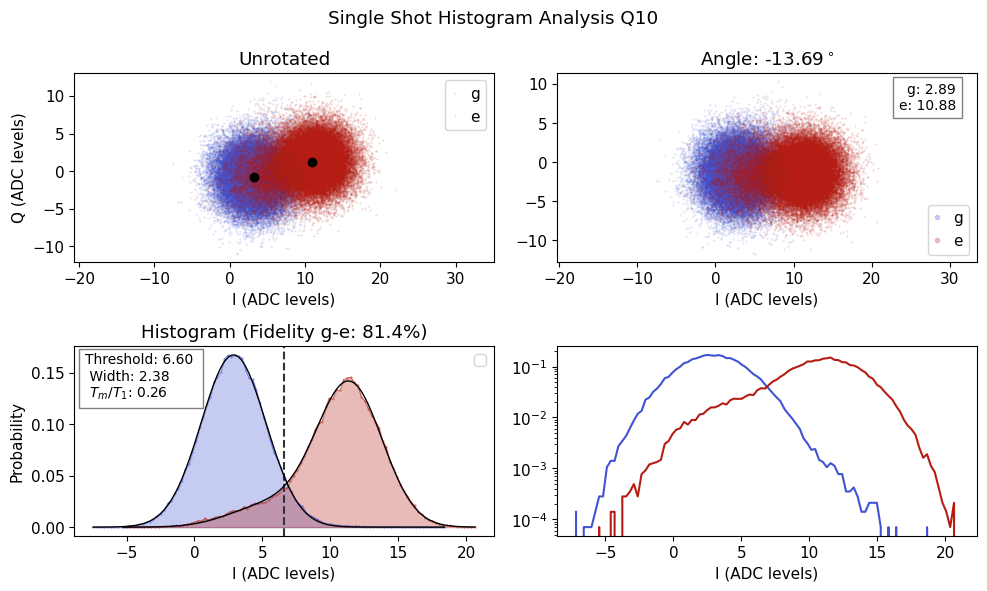

ge Fidelity (%): 81.410
Rotation angle (deg): -13.691
Threshold ge: 6.603
Reset is 0.00998392 of e and 0.974099 of g


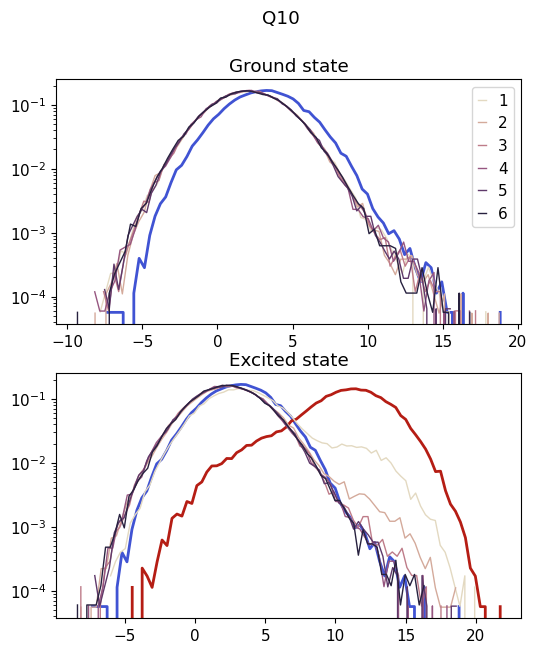

In [435]:
qubit_list = np.arange(11,20)
qubit_list =[10]
for qi in qubit_list:
    shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':50000,'active_reset':True})
    shot.check_reset()

# Chi

  0%|          | 0/5 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_chi_fine_qubit0_00012.h5


  0%|          | 0/2 [00:00<?, ?it/s]

Saving C:\_Data\LLotsa\Tuning_2025_01_11\resonator_spectroscopy_fine_qubit0_00083.h5


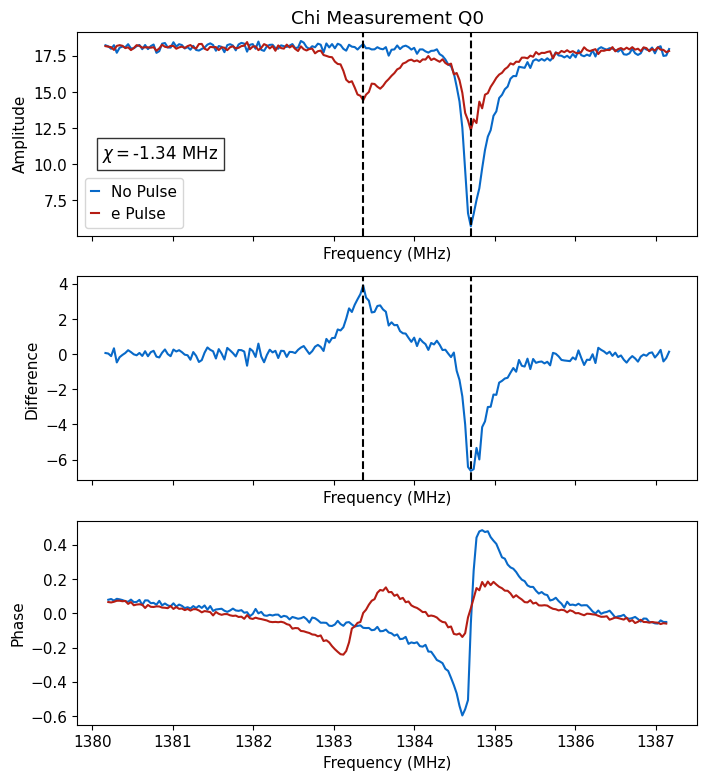

*Set cfg readout 0 chi to -1.3365 from -1.0199*


In [349]:
# Need a tuned up pi pulse for this
#for i in range(num_qubits):
qubit_list = [0]
for qi in qubit_list: 
    chi, chi_val=tuneup.check_chi(cfg_dict, qi)
    auto_cfg = config.update_readout(cfg_path, 'chi', float(chi_val), qi)


# 2 Qubit

  0%|          | 0/17880 [00:00<?, ?it/s]

R2:0.971	Fit par error:0.026	 Best fit:b'avgi'
R2:0.990	Fit par error:0.009	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\t1_Q10_Q0_00022.h5


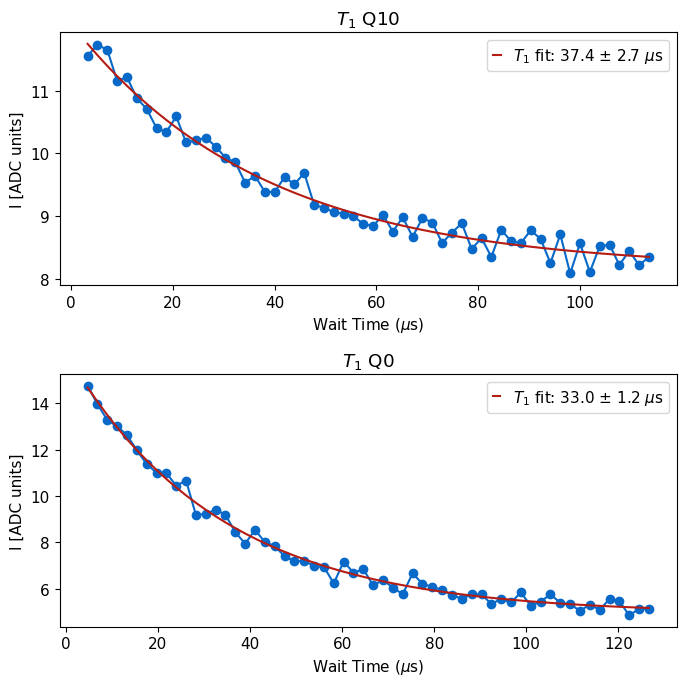

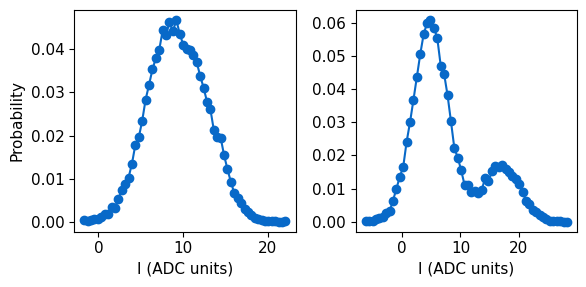

In [350]:
t12q = meas.T1_2Q(cfg_dict, qi=[10,0], params={'active_reset':False, })

In [ ]:
rabi2q = meas.Rabi_2Q(cfg_dict, qi=[10,0], params={'active_reset':True})

# EF 

In [ ]:
## Compare expected EF to actual
auto_cfg = config.load(cfg_path)

alpha=np.array(auto_cfg.device.qubit.f_ef)-np.array(auto_cfg.device.qubit.f_ge)
corr = np.array([188,210,168,186,155,171,187,145,157,169,188,210,168,186,155,171,187,145,157,169])

alpha+corr

#f_ef=np.array(auto_cfg.device.qubit.f_ge)-corr
#f_ef
#6,7,8, 11 16 18

### Initial setting of frequencies based on guess for alpha

In [ ]:
# Initial set of the frequencyies based on guess for alpha 
alpha = -180
qubit_list = np.arange(20)
auto_cfg = config.load(cfg_path)
for i in qubit_list: 
    f_ge = auto_cfg['device']['qubit']['f_ge'][i]
    auto_cfg = config.update_qubit(cfg_path, 'f_ef', f_ge+alpha, i)

## Spectroscopy EF

### General search

2


  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.840	Fit par error:0.026	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_medium_qubit0_00002.h5


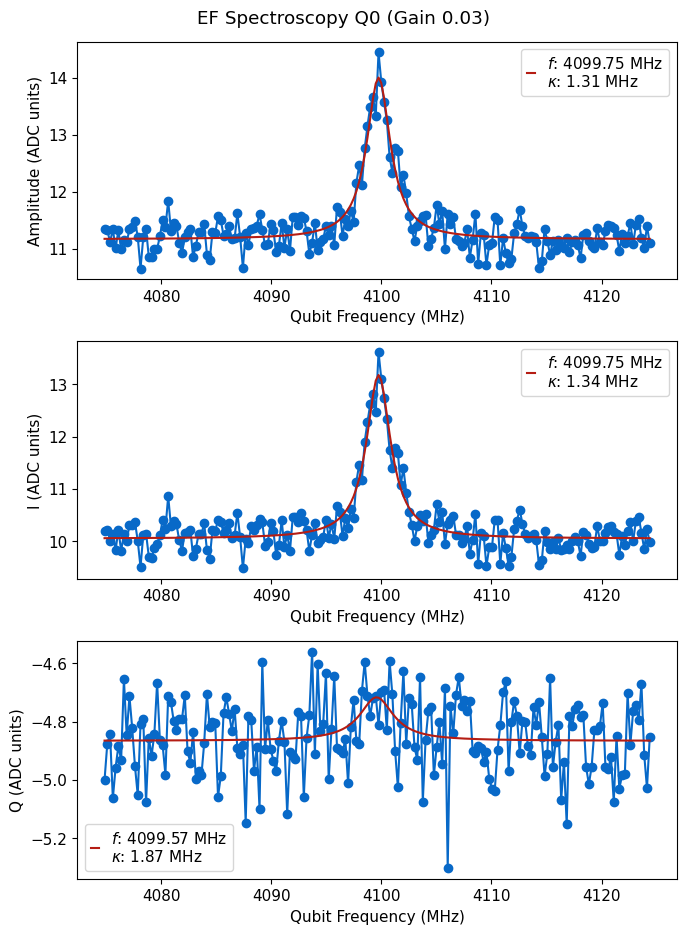

*Set cfg qubit 0 f_ef to 4099.7494 from 4099.6214*
3


  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.958	Fit par error:0.018	 Best fit:b'amps'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_fine_qubit0_00001.h5


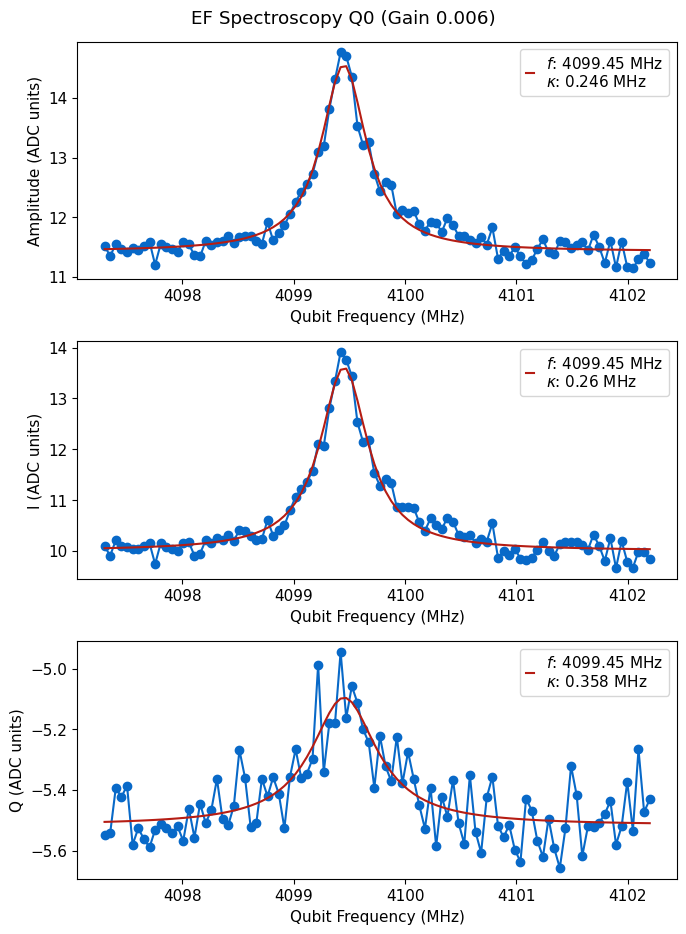

*Set cfg qubit 0 f_ef to 4099.4495 from 4099.7494*
Found qubit 0


In [353]:
qubit_list= np.arange(1,20)
bad_qubits=[]
qubit_list=[0]
for qi in qubit_list:
    status, ntries = qubit_tuning.find_spec(qi, cfg_dict, start='medium', freq='ef')
    if not status:
        bad_qubits.append(qi)

### Specific width

  0%|          | 0/135000 [00:00<?, ?it/s]

R2:0.828	Fit par error:0.027	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\qubit_spectroscopy_ef_medium_qubit0_00001.h5


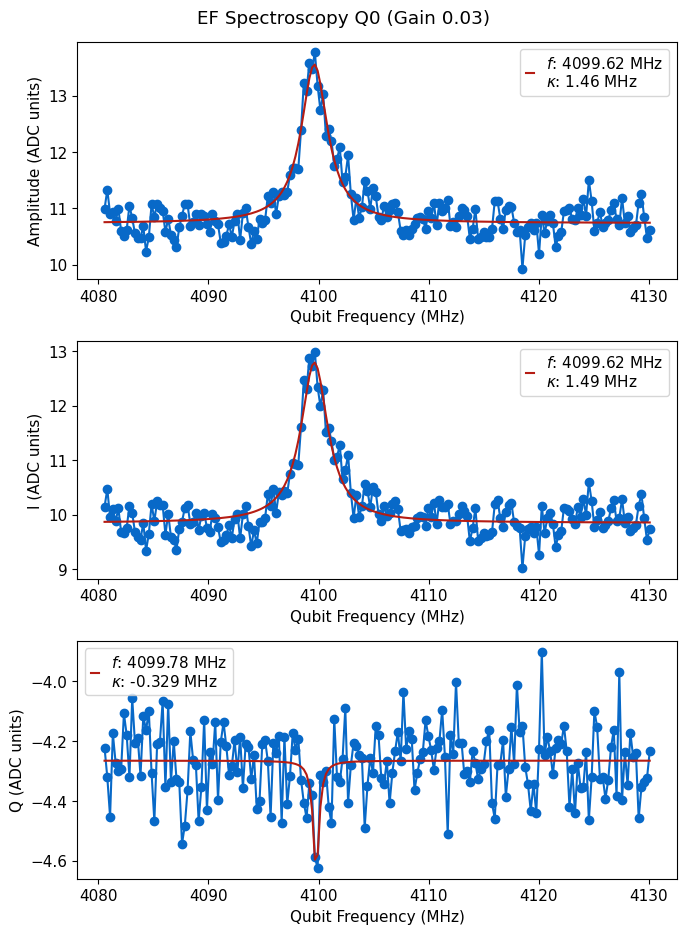

*Set cfg qubit 0 f_ef to 4099.6214 from 4105.32*


In [352]:
# You may want to update this frequency, which will be the center of the scan. 
#style huge, coarse, medium, fine 
update=True
qubit_list = np.arange(10)
qubit_list=[0]
for qi in qubit_list:
    qspec=meas.QubitSpec(cfg_dict, qi=qi, style='medium', params={'checkEF':True})#, params={'span':500, 'expts':1000,'reps':500,'gain':0.2})
    if update and qspec.status:
        auto_cfg = config.update_qubit(cfg_path, 'f_ef', float(qspec.data["best_fit"][2]), qi)

## Rabi EF

  0%|          | 0/8100 [00:00<?, ?it/s]

R2:0.986	Fit par error:0.012	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_qubit0_00016.h5


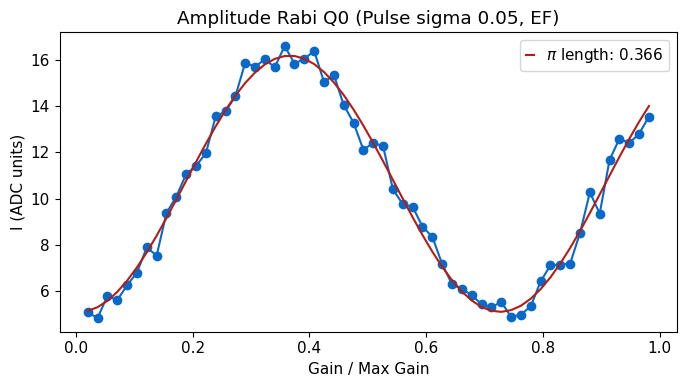

*Set cfg qubit 0 ('pulses', 'pi_ef', 'gain') to 0.3662 from 0.3639*


In [357]:
# If first time, initialize the sigma and gain to those of the ge 
first_time =False
update=True

qubit_list = np.arange(1,20)
qubit_list=[0]

bad_qubits = []
auto_cfg = config.load(cfg_path)

for qi in qubit_list: 
    if first_time:
        #config.update_qubit(cfg_path, 'f_ef', auto_cfg.device.qubit.f_spec_ef[qi], qi)
        auto_cfg = config.update_qubit(cfg_path, ('pulses','pi_ef','sigma'), auto_cfg['device']['qubit']['pulses']['pi_ge']['sigma'][qi], qi)
        auto_cfg = config.update_qubit(cfg_path, ('pulses','pi_ef','gain'), auto_cfg['device']['qubit']['pulses']['pi_ge']['gain'][qi], qi)
    amp_rabi = meas.RabiExperiment(cfg_dict,qi=qi, params={'checkEF':True})
    if update and amp_rabi.status:
        config.update_qubit(cfg_path, ('pulses','pi_ef','gain'), amp_rabi.data['pi_length'], qi)
    else:
        print(f'Amplitude Rabi fit failed for qubit {qi}')
        bad_qubits.append(qi)

## Qubit Temperature

  0%|          | 0/29700 [00:00<?, ?it/s]

R2:0.988	Fit par error:0.015	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_qubit12_00006.h5


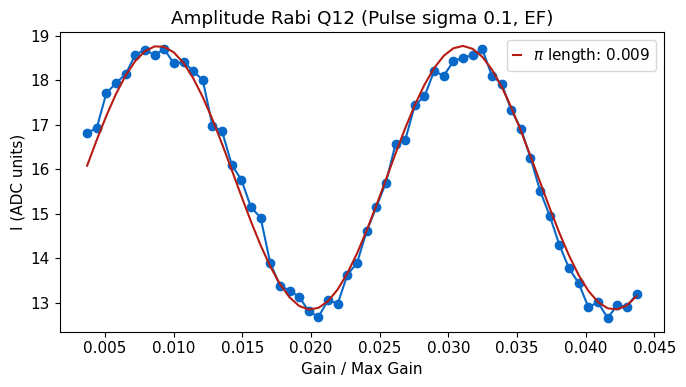

  0%|          | 0/200 [00:00<?, ?it/s]

R2:0.705	Fit par error:0.180	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\amp_rabi_ef_no_ge_qubit12_00001.h5


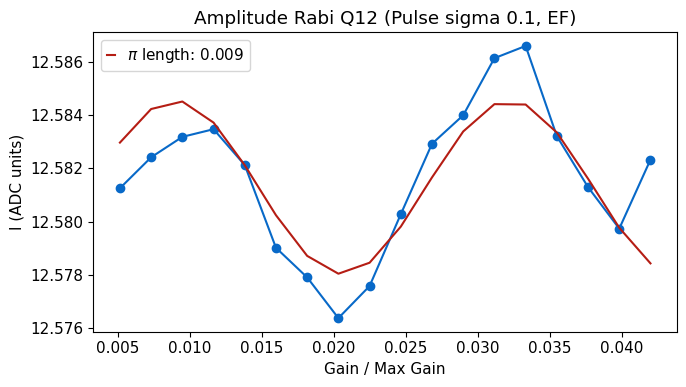

Qubit temp [mK]: 33.90443503247985
State preparation ratio: 0.0010949321079278375
2.965741321358196
0.0032472853965634196


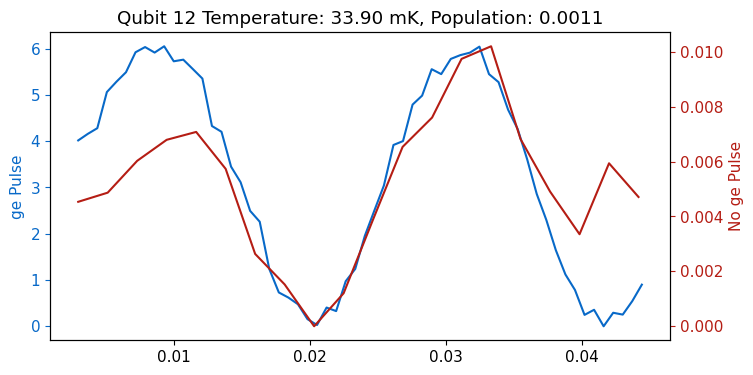

*Set cfg qubit 12 temp to 33.9044 from 32.0787*
*Set cfg qubit 12 pop to 0.0011 from 0.0007*


In [303]:
qubit_list = np.arange(1)
qubit_list=[12]
for qi in qubit_list: 
    temp, pop = tuneup.measure_temp(cfg_dict, qi=qi, soft_avgs=5)
    auto_cfg = config.update_qubit(cfg_path, 'temp', float(temp), qi)
    auto_cfg = config.update_qubit(cfg_path, 'pop', float(pop), qi)

In [304]:
0.01/6

0.0016666666666666668

## Ramsey EF

In [ ]:
qubit_list=np.arange(1,20)
qubit_list=[12]
for qi in qubit_list:
    t2r = meas.RamseyExperiment(cfg_dict, qi=qi, params={'ramsey_freq':0.1, 'checkEF':True})

    if t2r.status:
        config.update_qubit(cfg_path, 'f_ef', t2r.data['new_freq'], qi)
        #auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['best_fit'][3], qi, rng_vals=[1.5, max_t1], sig=2)
    else:
        print('T2 Ramsey fit failed')

# Time tracking of params

In [ ]:
qubit_list =np.arange(20)
qubit_list= [0,2,3,4,5,6,10,11,12,14,16]
time_track_data = [{'t1': [], 't2r': [],'t2e': [], 't1_data': [],'rx':[],'r_data':[], 't2r_data':[], 't2e_data':[], 'fid':[], 'phase':[], 't1x':[], 't2rx':[], 't2ex':[], 'fr':[],'fge':[]} for _ in qubit_list]
max_t1=500
update=True
#first, need to configure active reset and check stark for all. 
nexp = 2
t1_data = [[] for _ in qubit_list]
t2r_data = [[] for _ in qubit_list]
t2e_data = [[] for _ in qubit_list]
fid_data = [[] for _ in qubit_list]
phase_data = [[] for _ in qubit_list]
import time
start_time = time.time()
for i in range(nexp):
    
    for j, qi in enumerate(qubit_list):
        print(f"Starting run {i}/{nexp}, for qubit {qi}. Time elapsed {time.time()-start_time}")
        
        # Resonator spectroscopy 
        rspec = meas.ResSpec(cfg_dict, qi=qi, params={'span':'kappa'}, display=False, progress=False)
        auto_cfg = config.update_readout(cfg_path, 'frequency', rspec.data['fit'][0], qi, verbose=False)
        if rspec.status:
            auto_cfg = config.update_readout(cfg_path, 'qi', rspec.data['fit'][1], qi, verbose=False)
            auto_cfg = config.update_readout(cfg_path, 'qe', rspec.data['fit'][2], qi, verbose=False)
            auto_cfg = config.update_readout(cfg_path, 'kappa', rspec.data['kappa'], qi, rng_vals=[0.03, 10], verbose=False)
            time_track_data[j]['r_data'].append(rspec.data['amps'])

        shot=meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000}, display=False, progress=False)
        if update:
            config.update_readout(cfg_path, 'phase', shot.data['angle'], qi, verbose=False);
            config.update_readout(cfg_path, 'threshold', shot.data['thresholds'][0], qi, verbose=False);
            config.update_readout(cfg_path, 'fidelity', shot.data['fids'][0], qi, verbose=False);
            
        t1 = meas.T1Experiment(cfg_dict, qi=qi, display=False, progress=False)
        if t1.status:
            auto_cfg = config.update_qubit(cfg_path, 'T1', t1.data['new_t1_i'], qi,sig=2, rng_vals=[1.5, max_t1], verbose=False)
            time_track_data[j]['t1_data'].append(t1.data['avgi'])
            time_track_data[j]['t1'].append(t1.data['new_t1'])
        else:
            time_track_data[j]['t1_data'].append(np.nan*np.ones(len(t1.data['xpts'])))
            time_track_data[j]['t1'].append(np.nan)

        t2r = meas.RamseyExperiment(cfg_dict, qi=qi, display=False, progress=False)
        if t2r.data['fit_err_par'][1]<0.5:
            config.update_qubit(cfg_path, 'f_ge', t2r.data['new_freq'], qi, verbose=False)
            time_track_data[j]['t2r_data'].append(t2r.data['avgi'])
            time_track_data[j]['t2r'].append(t2r.data['fit_avgi'][3])
        else:
            time_track_data[j]['t2r_data'].append(np.nan*np.ones(len(t2r.data['xpts'])))
            time_track_data[j]['t2r'].append(np.nan)

        if t2r.data['fit_err_par'][3]<0.5:
            auto_cfg = config.update_qubit(cfg_path, 'T2r', t2r.data['fit_avgi'][3], qi,sig=2, rng_vals=[1.5, 2*max_t1], verbose=False)

        
        t2e = meas.RamseyEchoExperiment(cfg_dict, qi=qi, display=False, progress=False)
        if t2e.status:
            auto_cfg = config.update_qubit(cfg_path, 'T2e', t2e.data['fit_avgi'][3], qi,sig=2, rng_vals=[1.5, 2*max_t1], verbose=False)
            time_track_data[j]['t2e_data'].append(t2e.data['avgi'])
            time_track_data[j]['t2e'].append(t2e.data['fit_avgi'][3])
        else:
            time_track_data[j]['t2e_data'].append(np.nan*np.ones(len(t2e.data['xpts'])))
            time_track_data[j]['t2e'].append(np.nan)

        
        time_track_data[j]['t1x'].append(t1.data['xpts'])
        time_track_data[j]['rx'].append(rspec.data['xpts'])
        time_track_data[j]['t2rx'].append(t2r.data['xpts'])
        time_track_data[j]['t2ex'].append(t2e.data['xpts'])
        
        time_track_data[j]['fr'].append(rspec.data['fit'][0])
        time_track_data[j]['fge'].append(t2r.data['new_freq'])
        
        time_track_data[j]['phase'].append(shot.data['angle'])
        time_track_data[j]['fid'].append(shot.data['fids'][0])
    # plt.figure()
    # fig, ax = plt.subplots(1, 1, figsize=(15, 15))
    # #ax = ax.flatten()
    # for i, qi in enumerate(qubit_list):
    #     ax.plot(t1_data[i], label=f'Q{qi}')
    # ax.legend()



In [ ]:
%matplotlib inline
plot_line=True

plt.figure()
#qubit_list= [0,1,2,3,4,5,6,10,11,12,14,16]

nqub = len(qubit_list)
sns.set_palette('coolwarm',nqub)
fig, ax = plt.subplots(2, 4, figsize=(14, 8))
fig2, ax2 = plt.subplots(3,5, figsize=(15,15))
fig3, ax3 = plt.subplots(3,5, figsize=(15,15))
fig4, ax4 = plt.subplots(3,5, figsize=(15,15))
fig5, ax5 = plt.subplots(3,5, figsize=(15,15))
ax2 = ax2.flatten()
ax3 = ax3.flatten()
ax4 = ax4.flatten()
ax = ax.flatten()
ax5 = ax5.flatten()
for i, qi in enumerate(qubit_list):
    #if qi==10 or qi==11:
    #    continue
    phase = np.unwrap(np.array(time_track_data[i]['phase']))
    ax[0].plot(time_track_data[i]['t1']/ np.mean(time_track_data[i]['t1']),'o-', label=f'Q{qi}')
    ax[1].plot(time_track_data[i]['t2r']/ np.mean(time_track_data[i]['t2r']),'o-', label=f'Q{qi}')
    ax[2].plot(time_track_data[i]['t2e']/ np.mean(time_track_data[i]['t2e']),'o-', label=f'Q{qi}')
    ax[3].plot(phase- np.mean(phase),'o-', label=f'Q{qi}')
    ax[4].plot(time_track_data[i]['fid'],'o-', label=f'Q{qi}')
    ff=(1-np.array(time_track_data[i]['fid']))/(1-np.mean(time_track_data[i]['fid']))
    
    #ax[5].plot(ff,'o-', label=f'Q{qi}')
    ax[6].plot(time_track_data[i]['fr']-np.mean(time_track_data[i]['fr']),'o-', label=f'Q{qi}')
    ax[7].plot(time_track_data[i]['fge']-np.mean(time_track_data[i]['fge']),'o-', label=f'Q{qi}')
    if plot_line:
        for j in range(nexp):
            ax2[i].plot(time_track_data[i]['t1x'][j],time_track_data[i]['t1_data'][j],label=f'Q{qi}')
            ax3[i].plot(time_track_data[i]['t2rx'][j],time_track_data[i]['t2r_data'][j], label=f'Q{qi}')
            ax4[i].plot(time_track_data[i]['t2ex'][j],time_track_data[i]['t2e_data'][j], label=f'Q{qi}')
    else:
        ax2[i].pcolormesh(time_track_data[i]['t1_data'],label=f'Q{qi}')
        #ax2[i].pcolormesh(time_track_data[i]['t1x'][0], np.arange(len(time_track_data[i]['t1_data'][0])), time_track_data[i]['t1_data'], shading='auto')
        ax3[i].pcolormesh(time_track_data[i]['t2r_data'], label=f'Q{qi}')
        ax4[i].pcolormesh(time_track_data[i]['t2e_data'], label=f'Q{qi}')
        ax5[i].pcolormesh(time_track_data[i]['r_data'], label=f'Q{qi}')
    ax2[i].set_title(f'Q{qi} T1')
    ax3[i].set_title(f'Q{qi} T2r')
    ax4[i].set_title(f'Q{qi} T2e')

ax[0].set_ylabel('$T_1/\bar{T_1}$')
ax[1].set_ylabel('$T_{2r}/\bar{T_{2r}}$')
ax[2].set_ylabel('$T_{2e}/\bar{T_{2e}}$')
ax[3].set_ylabel('Phase')
ax[4].set_ylabel('Fidelity')  
fig.tight_layout()
ax[0].legend(ncol=2)

In [ ]:
ax2[i].pcolormesh(time_track_data[i]['t1x'][0], np.arange(len(time_track_data[i]['t1_data'][0])), time_track_data[i]['t1_data'][j], shading='auto')

In [ ]:
plt.figure()
sns.set_palette('coolwarm',20)
fig, ax = plt.subplots(1, 1, figsize=(15, 15))
#ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax.plot(t1_data[i]/ np.mean(t1_data[i]), label=f'Q{qi}')
    
ax.legend()

In [ ]:
#first, need to configure active reset and check stark for all. 
nexp = 3
qubit_list =np.arange(20)
t1_data = [[] for _ in qubit_list]

for i in range(nexp):
    for j, qi in enumerate(qubit_list):
        t1_cont = meas.T1Experiment(cfg_dict, qi=qi)
        t1_data[j].append(t1_cont.data['new_t1'])

plt.figure()
fig, ax = plt.subplots(5, 4, figsize=(15, 15))
ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax[i].set_title(f'Q{qi}')
    ax[i].pcolormesh(t1_data[i])
    plt.colorbar(ax[i].collections[0], ax=ax[i])

# Stark

## Ramsey

### Single experiment

c:\_Lib\python\slab_qick_calib\gen\qick_experiment.py:287: UserWarning: Unexpected parameters found in params: {'stark_freq'}
  warnings.warn(f"Unexpected parameters found in params: {unexpected_params}")


  0%|          | 0/2 [00:00<?, ?it/s]

R2:0.152	Fit par error:0.231	 Best fit:b'avgi'
Saving C:\_Data\LLotsa\Tuning_2025_01_11\ramsey_stark_qubit0_00001.h5


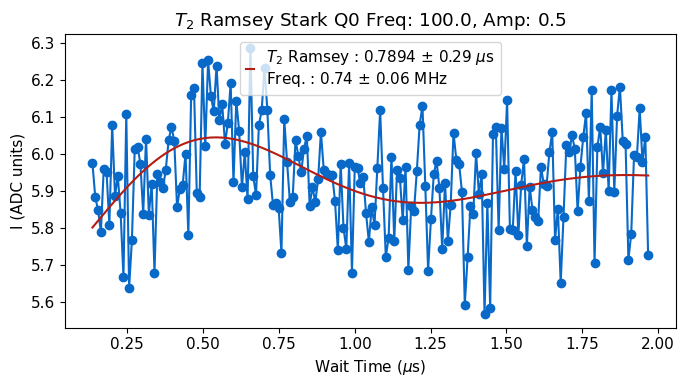

In [332]:
qi=0
meas.RamseyStarkExperiment(cfg_dict, qi=qi, params={'stark_gain':0.5,'step':0.01,'df':100})

### Sweep frequency

In [ ]:
qubit_list = np.arange(3,20)
qubit_list=[0]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkFreqExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'stark_gain':0.22, 'start_df':70, 'end_df':300, 'expts_df':25})

### Calibrate stark power positive freq

In [ ]:
qubit_list = np.arange(20)
qubit_list=[19]
d=[]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkPowerExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'expts_gain':12, 'df':70, 'start_gain':0.05, 'end_gain':0.5})
    d.append(t2rstark)
    config.update_stark(cfg_path, 'q', t2rstark.data['quad_fit'][0], qi)
    config.update_stark(cfg_path, 'l', t2rstark.data['quad_fit'][1], qi)
    config.update_stark(cfg_path, 'o', t2rstark.data['quad_fit'][2], qi)

### Negative frequency

In [ ]:
#qubit_list = np.arange(20)
d=[]
qubit_list=[19]
for qi in qubit_list:
    t2rstark=meas.RamseyStarkPowerExperiment(cfg_dict, qi=qi, params={'step':1/430+0.001, 'expts_gain':12, 'df':-100, 'start_gain':0.08, 'end_gain':0.35, 'soft_avgs':2})
    d.append(t2rstark)
    config.update_stark(cfg_path, 'qneg', t2rstark.data['quad_fit'][0], qi)
    config.update_stark(cfg_path, 'lneg', t2rstark.data['quad_fit'][1], qi)
    config.update_stark(cfg_path, 'oneg', t2rstark.data['quad_fit'][2], qi)
#handy.plot_many(d, title='Ramsey Stark', save_path=cfg_dict['expt_path'])

## T1

### Single exp

In [ ]:
t1 = meas.T1StarkExperiment(cfg_dict, qi=1, params={'active_reset':True, 'df':100}) 

### Gain sweep

In [ ]:
qi=6
t1_neg = meas.T1StarkPowerExperiment(cfg_dict, qi=qi, params={'df':-70,'start_gain':0.02,'end_gain':0.2,'start':3, 'soft_avgs':4})

t1_pos = meas.T1StarkPowerExperiment(cfg_dict, qi=qi, params={'df':100,'start_gain':0.02,'end_gain':0.4,'start':3, 'soft_avgs':4})#, 'start':100,'span':0.34, 'expts':100, 'soft_avgs':3})

### Freq sweep

In [ ]:
t1_freq = meas.T1StarkFreqExperiment(cfg_dict, qi=0, params={'reps':800, 'span':0.5, 'expts':150, 'span_f':50, 'start_df':50})

### Single evo point linear gain sweep

In [ ]:
t1_cont = meas.T1StarkPowerSingle(cfg_dict, qi=0, params={"soft_avgs":4})

### Run linear scan for multiple qubits

In [ ]:
#first, need to configure active reset and check stark for all. 
nexp = 3
qubit_list =[1,2]#2,4,5,6,7]
expts = 200
t1_data = [[] for _ in qubit_list]

for i in range(nexp):
    for j, qi in enumerate(qubit_list):
        t1_cont = meas.T1StarkPowerSingle(cfg_dict, qi=qi, params={ "soft_avgs":2,'expts':100})
        t1_data[j].append(t1_cont.data['t1'])

plt.figure()
fig, ax = plt.subplots(3, 2, figsize=(10, 10))
ax = ax.flatten()
for i, qi in enumerate(qubit_list):
    ax[i].set_title(f'Q{qi}')
    ax[i].pcolormesh(t1_data[i])
    plt.colorbar(ax[i].collections[0], ax=ax[i])

### Repeated single evo, sweep frequency linearly with gain [Main scan]

In [ ]:
d=[]
qi=6
params={'stop_f':20, 'df_pos':100, 'df_neg':-70}
for i in range(200):
    if i%10==0:
        t1stark=meas.T1StarkPowerQuadSingle(cfg_dict, qi=qi, params=params)
        shot = meas.HistogramExperiment(cfg_dict, qi=qi, params={'shots':20000})
        config.update_readout(cfg_path, 'threshold',shot.data['thresholds'][0], qi);
        config.update_readout(cfg_path, 'phase', shot.data['angle'], qi);
        phase.append(shot.data['angle'])
    else:
        t1stark=meas.T1StarkPowerQuadSingle(cfg_dict, qi=qi, params=params, display=False, progress=False)

    d.append(t1stark)

times = [d[i].data['start_time'] for i in range(0, len(d))] 
tm = [datetime.strptime(times[i].decode('utf-8'), '%Y-%m-%d %H:%M:%S') for i in range(len(times))]
time_from_first = [(t - tm[0]).total_seconds() for t in tm]
print(time_from_first)

concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(0, len(d))], axis=1)

plt.figure()
plt.pcolormesh(concatenated_data)

In [ ]:
plt.figure()
concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(0, len(d))], axis=1)
import matplotlib.dates as mdates

plt.pcolormesh(np.array(time_from_first)/60/60, d[-1].data['f_pts'], concatenated_data)
#plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M'))
#plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))
#plt.gcf().autofmt_xdate()


### Multiple time evos (not currently using)

In [ ]:
t1stark=meas.T1StarkPowerQuadMulti(cfg_dict, qi=0, params={'stop_f':25, 'df_pos':100, 'df_neg':-90, 'active_reset':True})

### Calib sweep

### Analysis of multiple evo times using normal fittingh

In [ ]:
# Processing for multiple evo times 
cd0 = np.concatenate([d[i].data['avgi_0'] for i in range(0, len(d))], axis=1)
cd1 = np.concatenate([d[i].data['avgi_1'] for i in range(0, len(d))], axis=1)
cd2 = np.concatenate([d[i].data['avgi_2'] for i in range(0, len(d))], axis=1)
cd3 = np.concatenate([d[i].data['avgi_3'] for i in range(0, len(d))], axis=1)

combined_cd = np.stack((cd0, cd1, cd2, cd3), axis=-1)
print(combined_cd.shape)

tms=d[0].data['wait_times']

sns.set_palette('coolwarm',len(combined_cd))
from scipy.optimize import curve_fit
plt.figure()
def t1_fit(x, a, b, c):
    return b * np.exp(-x / c) + a
fits=[]
tm_full = np.linspace(0, tms[3])
#for i in range(5):
for i in range(len(combined_cd)):
    plt.plot(tms, combined_cd[i][0][:],'o-')
    p0 = (np.min(combined_cd[i][0][:]), np.max(combined_cd[i][0][:])-np.min(combined_cd[i][0][:]), tms[2])
    popt, err = curve_fit(t1_fit, tms, combined_cd[i][0][:], p0=p0)
    fit_err = np.sqrt(np.diag(err))   
    if np.mean(fit_err/np.abs(popt))>0.5:
        fits.append(np.nan*np.ones(3))   
    else:
        fits.append(popt)
    #print(p0)
    #plt.plot(tm_full, t1_fit(np.array(tm_full), *popt),'k', label=f'Fit {i}')
    #print(popt)
#plt.legend()
t1_data = [fits[i][2] for i in range(len(fits))]    
offset = [fits[i][0] for i in range(len(fits))]
amp = [fits[i][1] for i in range(len(fits))]

fig, ax = plt.subplots(3, 1, figsize=(8, 7))
ax[0].plot(t1_data, 'o-')
ax[1].plot(offset, 'o-')
ax[2].plot(amp, 'o-')

In [ ]:
# Concatenate all d[i].data['avgi'] into a single dataset
concatenated_data = np.concatenate([d[i].data['avgi'] for i in range(1, len(d))], axis=1)

#print(concatenated_data)

plt.figure()
plt.pcolormesh(concatenated_data)

#### Check max value for calibration

In [ ]:
np.max(t1.data['avgi'], axis=1)
plt.figure()
plt.plot(np.max(t1.data['avgi'], axis=1))